In [ ]:
# !pip install catboost imblearn joblib lightgbm matplotlib numpy optuna mlflow scikit-learn pandas seaborn tqdm ucimlrepo xgboost kaleido

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 64.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.6/383.6 kB 22.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 28.2/28.2 MB 36.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.1/6.1 MB 70.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.8/231.8 kB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.8/147.8 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.9/114.9 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 677.5/677.5 kB 31.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.9/94.9 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 203.

In [ ]:
from collections import Counter, defaultdict
from itertools import combinations
import time
import warnings

from catboost import CatBoostClassifier
from imblearn.over_sampling import SMOTE
import joblib
from lightgbm import LGBMClassifier
import matplotlib.gridspec as GridSpec
import matplotlib.pyplot as plt
import numpy as np
import optuna
from urllib.parse import urlparse
import os
import mlflow
import mlflow.sklearn
import pickle
from collections import Counter
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from lightgbm import LGBMClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from optuna.visualization import plot_optimization_history, plot_param_importances
import pandas as pd
import seaborn as sns
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    f1_score,
    roc_auc_score,
)
from sklearn.model_selection import StratifiedKFold, cross_val_score, train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from tqdm import tqdm
from ucimlrepo import fetch_ucirepo
from xgboost import XGBClassifier

In [ ]:
# Configurações
np.random.seed(42)  # Para reprodutibilidade
plt.style.use("ggplot")

# Parâmetros do algoritmo genético
POPULATION_SIZE = 20
MIN_FEATURES = 2
MAX_FEATURES = 14  # Limitado pelo maior k testado
MAX_GENERATIONS = 15
ELITE_PERCENT = 0.2
MUTATION_PROBABILITY = 0.1

In [ ]:
from google.colab import drive

drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
%cd '/content/drive/MyDrive/TG - Data'

/content/drive/MyDrive/TG - Data


# Data Loading

In [ ]:
national_poll_on_healthy_agig_npha = fetch_ucirepo(id=936)
X = national_poll_on_healthy_agig_npha.data.features
y = national_poll_on_healthy_agig_npha.data.targets
df = pd.merge(X, y, left_index=True, right_index=True)

# 1. EDA

## Checagem básica
Nessa etapa veremos a dimensão, se o dataset possui valores nulos e valores duplicados

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 714 entries, 0 to 713
Data columns (total 15 columns):
 #   Column                                      Non-Null Count  Dtype
---  ------                                      --------------  -----
 0   Age                                         714 non-null    int64
 1   Physical_Health                             714 non-null    int64
 2   Mental_Health                               714 non-null    int64
 3   Dental_Health                               714 non-null    int64
 4   Employment                                  714 non-null    int64
 5   Stress_Keeps_Patient_from_Sleeping          714 non-null    int64
 6   Medication_Keeps_Patient_from_Sleeping      714 non-null    int64
 7   Pain_Keeps_Patient_from_Sleeping            714 non-null    int64
 8   Bathroom_Needs_Keeps_Patient_from_Sleeping  714 non-null    int64
 9   Uknown_Keeps_Patient_from_Sleeping          714 non-null    int64
 10  Trouble_Sleeping                      

In [ ]:
print(f"Qtde Valores Nulos: {df.isnull().sum()}")

print(f"Qtde Valores Duplicados: {df.duplicated().sum()}")

Qtde Valores Nulos: Age                                           0
Physical_Health                               0
Mental_Health                                 0
Dental_Health                                 0
Employment                                    0
Stress_Keeps_Patient_from_Sleeping            0
Medication_Keeps_Patient_from_Sleeping        0
Pain_Keeps_Patient_from_Sleeping              0
Bathroom_Needs_Keeps_Patient_from_Sleeping    0
Uknown_Keeps_Patient_from_Sleeping            0
Trouble_Sleeping                              0
Prescription_Sleep_Medication                 0
Race                                          0
Gender                                        0
Number_of_Doctors_Visited                     0
dtype: int64
Qtde Valores Duplicados: 42


**Mapeamento dos Dados**: Irei alterar a distribuição de alguns dos valores para fazer mais sentido para minha ordenação

In [ ]:
# Mapeamento dos valores das features conforme solicitado
print("Aplicando mapeamento de valores às features...")

# Physical_Health e Mental_Health
health_mapping = {-1: 0, 5: 1, 4: 2, 3: 3, 2: 4, 1: 5}
df["Physical_Health"] = (
    df["Physical_Health"].map(health_mapping).fillna(df["Physical_Health"])
)
df["Mental_Health"] = (
    df["Mental_Health"].map(health_mapping).fillna(df["Mental_Health"])
)

# Dental_Health
dental_mapping = {
    -1: 0,
    5: 1,
    4: 2,
    3: 3,
    2: 4,
    1: 5,
}  # Usando 5 como substituição para 6
# Verificar se algum valor 6 existe e substituir pela mediana se necessário
if 6 in df["Dental_Health"].values:
    median_value = df[df["Dental_Health"].between(1, 5)]["Dental_Health"].median()
    dental_mapping[6] = median_value
df["Dental_Health"] = (
    df["Dental_Health"].map(dental_mapping).fillna(df["Dental_Health"])
)

# Employment
employment_mapping = {
    1: 3,
    2: 2,
    3: 1,
    4: 0,
    -1: 0,
}  # Adicionei -1: 0 para tratar recusas
df["Employment"] = df["Employment"].map(employment_mapping).fillna(df["Employment"])

# Prescription_Sleep_Medication
medication_mapping = {-1: 0, 1: 3, 2: 2, 3: 1}
df["Prescription_Sleep_Medication"] = (
    df["Prescription_Sleep_Medication"]
    .map(medication_mapping)
    .fillna(df["Prescription_Sleep_Medication"])
)

df = df.astype(int)

print("Mapeamento concluído.")

Aplicando mapeamento de valores às features...
Mapeamento concluído.


In [ ]:
feature_mappings = {
    "Number of Doctors Visited": {1: "0-1 doctors", 2: "2-3 doctors", 3: "4+ doctors"},
    "Age": {1: "50-64", 2: "65-80"},
    "Physical Health": {
        0: "Refused",
        1: "Poor",
        2: "Fair",
        3: "Good",
        4: "Very Good",
        5: "Excellent",
    },
    "Mental Health": {
        0: "Refused",
        1: "Poor",
        2: "Fair",
        3: "Good",
        4: "Very Good",
        5: "Excellent",
    },
    "Dental Health": {
        0: "Refused",
        1: "Poor",
        2: "Fair",
        3: "Good",
        4: "Very Good",
        5: "Excellent",
    },
    "Employment": {
        0: "Not working/Refused",
        1: "Retired",
        2: "Working part-time",
        3: "Working full-time",
    },
    "Stress Keeps Patient from Sleeping": {0: "No", 1: "Yes"},
    "Medication Keeps Patient from Sleeping": {0: "No", 1: "Yes"},
    "Pain Keeps Patient from Sleeping": {0: "No", 1: "Yes"},
    "Bathroom Needs Keeps Patient from Sleeping": {0: "No", 1: "Yes"},
    "Uknown Keeps Patient from Sleeping": {0: "No", 1: "Yes"},
    "Trouble Sleeping": {0: "No", 1: "Yes", 2: "Sometimes", 3: "Unknown"},
    "Prescription Sleep Medication": {
        0: "Refused",
        1: "Do not use",
        2: "Use occasionally",
        3: "Use regularly",
    },
    "Race": {
        -2: "Not asked",
        -1: "Refused",
        1: "White, Non-Hispanic",
        2: "Black, Non-Hispanic",
        3: "Other, Non-Hispanic",
        4: "Hispanic",
        5: "2+ Races, Non-Hispanic",
    },
    "Gender": {-2: "Not asked", -1: "Refused", 1: "Male", 2: "Female"},
}

**Conclusão da Etapa**: Nessa etapa vimos que não temos nenhum dado nulo, mas vimos que temos linhas duplicadas no conjunto de dados. Iremos removê-las na etapa de tratamento dos dados pois tratam-se de dados redundantes

## Visualização dos Dados
Nessa etapa iremos utilizar as visualizações de Barplots, Boxplots, Violin Plots e Heatmaps

In [ ]:
# Função para criar um mosaico de barplots
def create_barplot_mosaic(save_image=False, save_path="."):
    # Definir o número de colunas e calcular o número de linhas necessárias
    n_cols = 3
    n_rows = int(np.ceil(len(df.columns) / n_cols))

    # Criar a figura
    plt.figure(figsize=(20, 5 * n_rows))

    # Plotar barplots para cada feature
    for i, col in enumerate(df.columns):
        plt.subplot(n_rows, n_cols, i + 1)

        # Contar os valores para cada categoria
        value_counts = df[col].value_counts().sort_index()

        # Criar barplot
        ax = sns.barplot(x=value_counts.index, y=value_counts.values)

        # Ajustar os ticks do eixo x
        plt.xticks(
            range(len(value_counts)),
            [str(val) for val in value_counts.index],
            rotation=45,
            ha="right",
        )

        plt.title(f"Distribuição de {col}")
        plt.tight_layout()

    plt.suptitle("Mosaico de Barplots para todas as Features", fontsize=20, y=1.02)
    plt.tight_layout()

    if save_image:
        plt.savefig(f"{save_path}/barplot_mosaic.png", dpi=300, bbox_inches="tight")

    plt.show()


# Função para criar um mosaico de boxplots
def create_boxplot_mosaic(save_image=False, save_path="."):
    # Definir o número de colunas e calcular o número de linhas necessárias
    n_cols = 3
    n_rows = int(np.ceil(len(df.columns) / n_cols))

    # Criar a figura
    plt.figure(figsize=(20, 5 * n_rows))

    # Plotar boxplots para cada feature
    for i, col in enumerate(df.columns):
        plt.subplot(n_rows, n_cols, i + 1)

        # Criar boxplot
        sns.boxplot(x=df[col])

        plt.title(f"Boxplot de {col}")
        plt.tight_layout()

    plt.suptitle("Mosaico de Boxplots para todas as Features", fontsize=20, y=1.02)
    plt.tight_layout()

    if save_image:
        plt.savefig(f"{save_path}/boxplot_mosaic.png", dpi=300, bbox_inches="tight")

    plt.show()


# Função para criar um mosaico de violin plots
def create_violinplot_mosaic(save_image=False, save_path="."):
    # Definir o número de colunas e calcular o número de linhas necessárias
    n_cols = 3
    n_rows = int(np.ceil(len(df.columns) / n_cols))

    # Criar a figura
    plt.figure(figsize=(20, 5 * n_rows))

    # Plotar violin plots para cada feature
    for i, col in enumerate(df.columns):
        plt.subplot(n_rows, n_cols, i + 1)

        # Criar violin plot
        sns.violinplot(x=df[col])

        plt.title(f"Violin Plot de {col}")
        plt.tight_layout()

    plt.suptitle("Mosaico de Violin Plots para todas as Features", fontsize=20, y=1.02)
    plt.tight_layout()

    if save_image:
        plt.savefig(f"{save_path}/violinplot_mosaic.png", dpi=300, bbox_inches="tight")

    plt.show()


# Função para criar um mapa de calor de correlação
def create_correlation_heatmap(save_image=False, save_path=".", linear_corr=True):
    # Criar a figura
    plt.figure(figsize=(16, 14))

    # Calcular a matriz de correlação
    if linear_corr:
        corr_matrix = df.corr(method="pearson")
    else:
        corr_matrix = df.corr(method="spearman")

    # Criar o mapa de calor
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
    sns.heatmap(
        corr_matrix,
        annot=True,
        fmt=".2f",
        cmap="coolwarm",
        mask=mask,
        square=True,
        linewidths=0.5,
    )

    plt.title("Mapa de Calor de Correlação", fontsize=20)
    plt.tight_layout()

    if save_image:
        plt.savefig(
            f"{save_path}/correlation_heatmap.png", dpi=300, bbox_inches="tight"
        )

    plt.show()


# Função para criar um mosaico de scatter plots entre o target e as features
def create_scatter_mosaic(save_image=False, save_path="."):
    target = "Number_of_Doctors_Visited"
    features = [col for col in df.columns if col != target]

    # Definir o número de colunas e calcular o número de linhas necessárias
    n_cols = 3
    n_rows = int(np.ceil(len(features) / n_cols))

    # Criar a figura
    plt.figure(figsize=(20, 5 * n_rows))

    # Mapear as cores para os valores do target
    colors = {1: "blue", 2: "green", 3: "red"}

    # Plotar a relação de cada feature com o target usando scatter plot
    for i, feature in enumerate(features):
        plt.subplot(n_rows, n_cols, i + 1)

        # Adicionar jitter para melhor visualização (dados discretos podem se sobrepor)
        x = df[feature] + np.random.normal(0, 0.1, size=len(df))
        y = df[target] + np.random.normal(0, 0.1, size=len(df))

        # Criar scatter plot com cores baseadas no target
        for target_val in sorted(df[target].unique()):
            mask = df[target] == target_val
            plt.scatter(
                x[mask],
                y[mask],
                alpha=0.5,
                label=f"Classe {target_val}",
                color=colors.get(target_val, f"C{target_val}"),
            )

        # Ajustar limites para melhor visualização
        plt.xlim(df[feature].min() - 0.5, df[feature].max() + 0.5)
        plt.ylim(df[target].min() - 0.5, df[target].max() + 0.5)

        # Ajustar ticks para mostrar apenas os valores originais
        plt.xticks(sorted(df[feature].unique()))
        plt.yticks(sorted(df[target].unique()))

        # Adicionar linhas de grade para facilitar a visualização
        plt.grid(True, linestyle="--", alpha=0.7)

        plt.xlabel(feature)
        plt.ylabel(target)
        plt.title(f"Relação entre {feature} e {target}")

        # Adicionar legenda apenas no primeiro gráfico
        if i == 0:
            plt.legend()

    plt.suptitle(
        f"Scatter Plots: Relações entre Features e {target}", fontsize=20, y=1.02
    )
    plt.tight_layout()

    if save_image:
        plt.savefig(f"{save_path}/scatter_mosaic.png", dpi=300, bbox_inches="tight")

    plt.show()

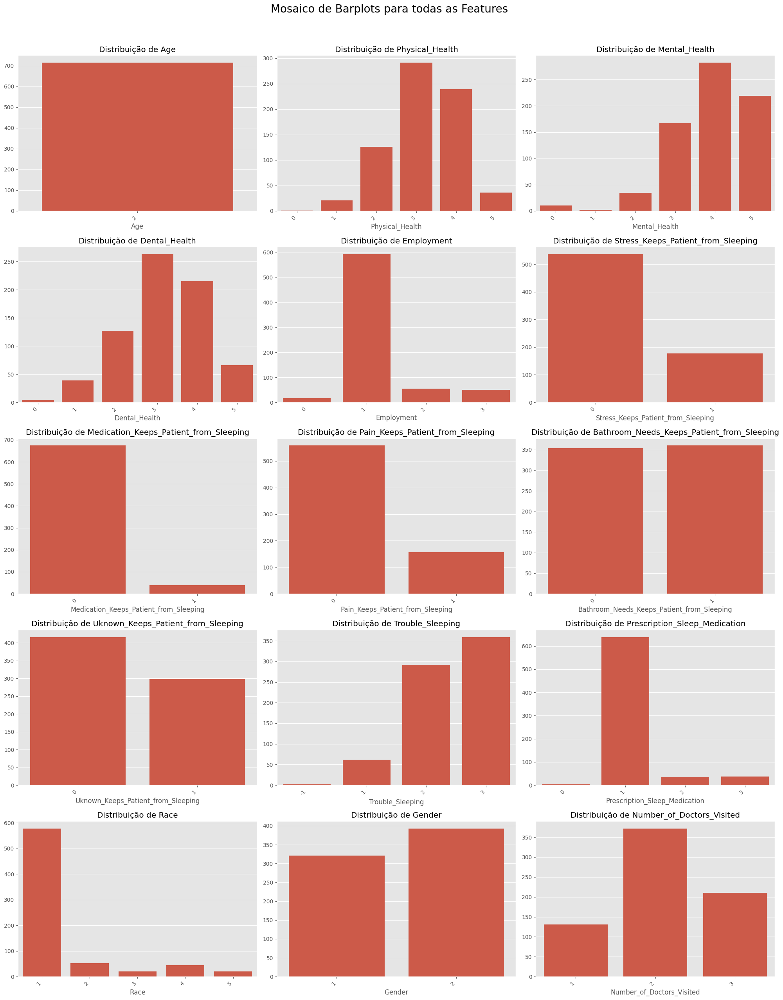

In [ ]:
create_barplot_mosaic()

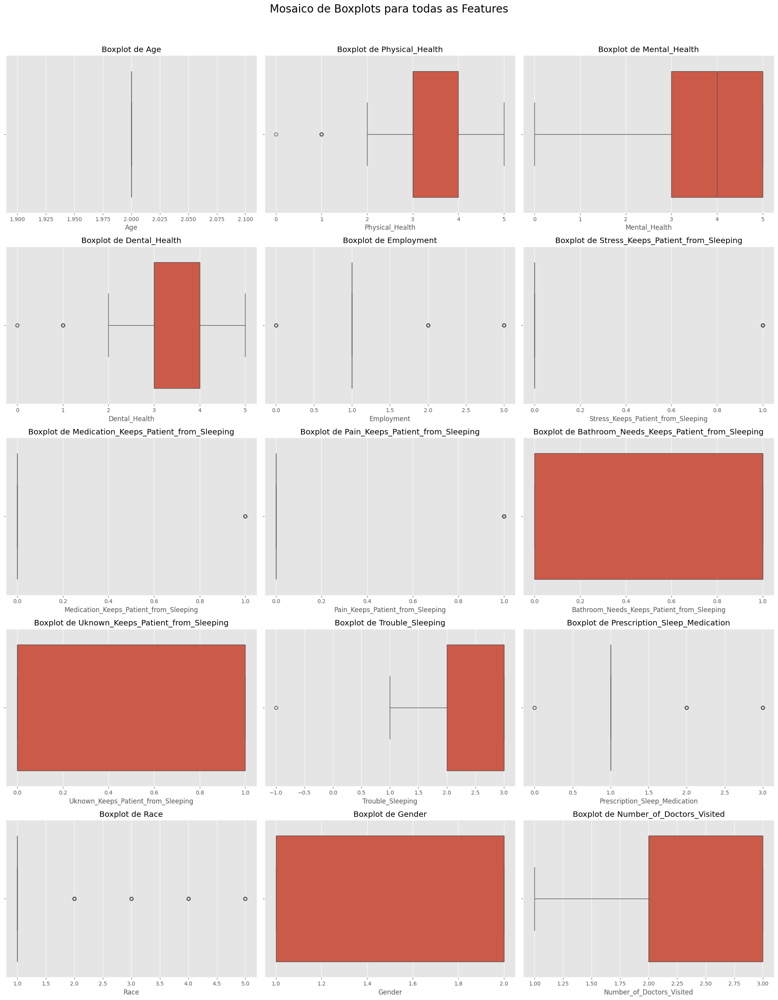

In [ ]:
create_boxplot_mosaic()

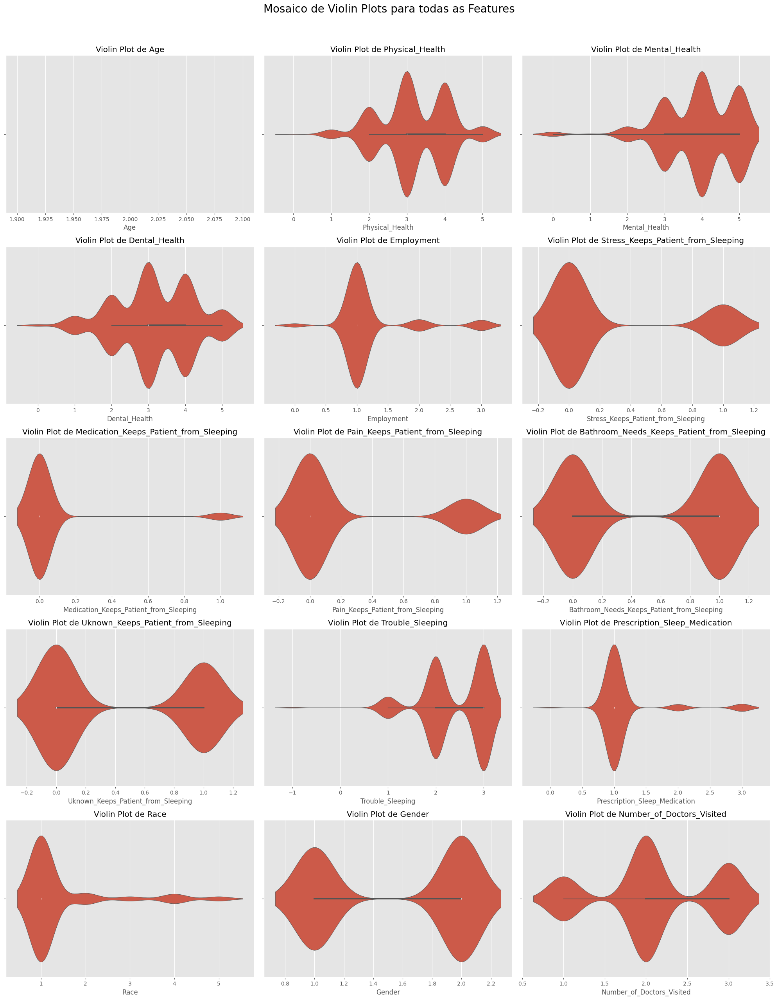

In [ ]:
create_violinplot_mosaic()

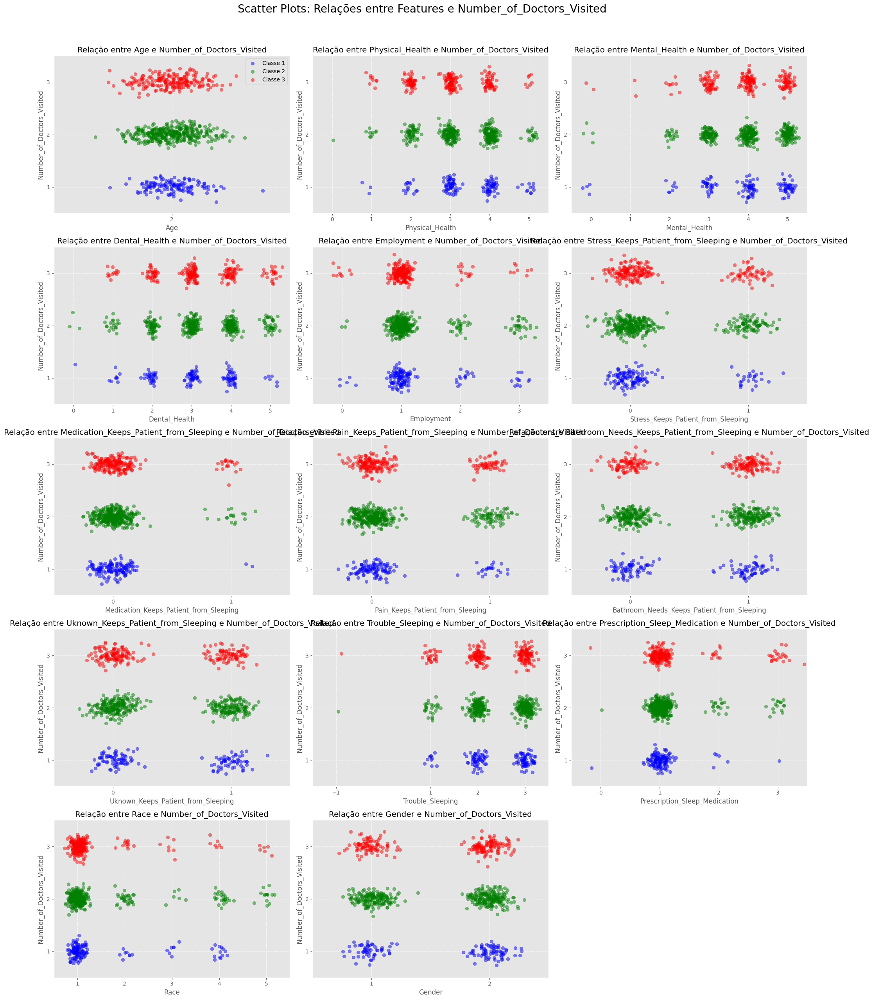

In [ ]:
create_scatter_mosaic()

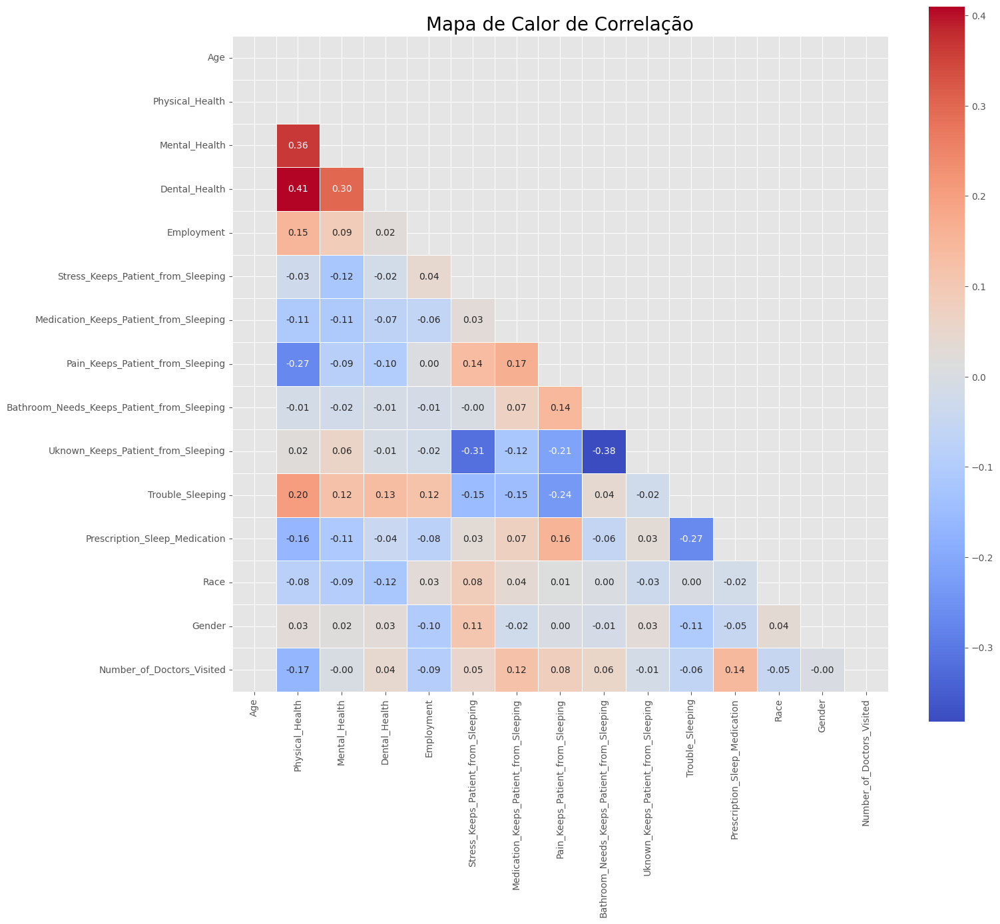

In [ ]:
create_correlation_heatmap()

**Conclusão**: Ao analisar as features, tivemos as seguintes conclusões
1. No geral, muitas features do dataset apresentam pouca variabilidade
2. A target não tem uma correlaÇão linear muito forte com nenhuma feature
3. O número de visitas aos médicos não tem correlação com o estado mental dos indivíduos. Isso é inesperado.
4. A coluna de idade e gênero não tem correlação nenhuma com a target e podem ser dropada.
5. Por termos apenas variáveis categóricas e binárias, não teremos necessidade
de normalizar as features
6. O ideal é que usemos o SMOTE na etapa de treinamento devido ao desbalancemanto das features
7. Não temos colunas duplas, então não precisaremos fazer imputação das features, mas precisaremos remover as features duplicadas.
8. Um repameanto dos valores das features foi feito para fazer mais sentido e
precisamos mudar o valor '6' de Dental_Health para o valor da mediana, já que ele não estava presente
na descrição do dataset, indicando um ruído.
9. Trouble sleeping terá que ser dropada pois ela deveria ser binária e apresenta 3 valores (1, 2 e 3). Isso indica forte ruído e não tenho ideias
de como corrigir isso

# 2. Data Cleaning
Visando a Preparar o Conjunto de Dados para a modelagem, nessa etapa:
1. Iremos remover as linhas duplicadas
2. Iremos dividir os dados em 10 conjuntos menores utilizando o StratifiedKfold, além de enriquecermos os dados de treino utilizando SMOTE


In [ ]:
df = df.drop_duplicates()

In [ ]:
# Preparar X e y
X = df.drop("Number_of_Doctors_Visited", axis=1)
y = df["Number_of_Doctors_Visited"]

# Inicializar StratifiedKFold
skf = StratifiedKFold(n_splits=10, shuffle=True)

# Inicializar SMOTE
smote = SMOTE()

# Lista para armazenar os folds
smote_folds_data = []
original_folds_data = []

# Para cada fold
for train_index, test_index in skf.split(X, y):
    # Obter os subconjuntos originais
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    # Aplicar SMOTE no conjunto de treino
    X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

    # Converter para DataFrame se X_train_smote retornar um array
    if not isinstance(X_train_smote, pd.DataFrame):
        X_train_smote = pd.DataFrame(X_train_smote, columns=X.columns)

    # Mostrar distribuição das classes antes e depois do SMOTE
    print(f"Fold - Distribuição original: {Counter(y_train)}")
    print(f"Fold - Distribuição após SMOTE: {Counter(y_train_smote)}")

    # Adicionar o fold à lista
    smote_folds_data.append((X_train_smote, X_test, y_train_smote, y_test))
    original_folds_data.append((X_train, X_test, y_train, y_test))

Fold - Distribuição original: Counter({2: 304, 3: 180, 1: 111})
Fold - Distribuição após SMOTE: Counter({3: 304, 2: 304, 1: 304})
Fold - Distribuição original: Counter({2: 304, 3: 180, 1: 111})
Fold - Distribuição após SMOTE: Counter({3: 304, 1: 304, 2: 304})
Fold - Distribuição original: Counter({2: 304, 3: 180, 1: 112})
Fold - Distribuição após SMOTE: Counter({3: 304, 2: 304, 1: 304})
Fold - Distribuição original: Counter({2: 304, 3: 180, 1: 112})
Fold - Distribuição após SMOTE: Counter({3: 304, 2: 304, 1: 304})
Fold - Distribuição original: Counter({2: 304, 3: 180, 1: 112})
Fold - Distribuição após SMOTE: Counter({2: 304, 3: 304, 1: 304})
Fold - Distribuição original: Counter({2: 304, 3: 180, 1: 112})
Fold - Distribuição após SMOTE: Counter({3: 304, 2: 304, 1: 304})
Fold - Distribuição original: Counter({2: 304, 3: 180, 1: 112})
Fold - Distribuição após SMOTE: Counter({3: 304, 2: 304, 1: 304})
Fold - Distribuição original: Counter({2: 304, 3: 180, 1: 112})
Fold - Distribuição após S

# 3. Feature Engineering
Nesta etapa iremos escolher as melhores features do dataset com a seguinte metodologia:
1. Utilizaremos LR, RF, KNN, NB e Catboost para avaliar os datasets.
2. Separaremos uma cópia do dataset original
3. Utilizaremos o método anova e selecionaremos *k* features, com o valor de *k* variando entre 7 e 11 features, em que tiraremos a media do AUC_SCORE para o grupo de classificadores avaliadores. O *k* com melhor média será escolhido para a avalição final.
4. Utilizaremos algoritmo genético junto com random forests para selecionar o melhor subconjunto de features utilizando uma abordagem do tipo *wrapper*
5. Selecionaremos as features com melhor média de auc_score para o conjunto de classificadores.

**MlFlow Tracking**

In [ ]:
def setup_mlflow(experiment_name="Busca das Features", sqlite_path="mlruns.db"):
    """
    Configura o MLflow para registrar experimentos em um banco de dados SQLite

    Args:
        experiment_name: Nome do experimento
        sqlite_path: Caminho para o arquivo SQLite

    Returns:
        experiment_id: ID do experimento criado ou recuperado
    """
    # Configurar o tracking URI para o SQLite
    mlflow_tracking_uri = f"sqlite:///{sqlite_path}"
    mlflow.set_tracking_uri(mlflow_tracking_uri)

    # Criar ou obter o experimento
    try:
        experiment_id = mlflow.create_experiment(
            experiment_name, artifact_location=os.path.join(os.getcwd(), "mlruns")
        )
        print(f"Experimento '{experiment_name}' criado com ID: {experiment_id}")
    except mlflow.exceptions.MlflowException:
        # Experimento já existe, recuperar ID
        experiment_id = mlflow.get_experiment_by_name(experiment_name).experiment_id
        print(f"Experimento '{experiment_name}' já existe com ID: {experiment_id}")

    mlflow.set_experiment(experiment_name)

    return experiment_id


def log_feature_selection_results(
    model_name, model, method, features, mean_auc, std_auc, fold_aucs, k=None
):
    """
    Registra os resultados de um método de seleção de features no MLflow

    Args:
        model_name: Nome do modelo
        model: Objeto do modelo scikit-learn
        method: Nome do método de seleção de features ('all', 'anova', 'ga')
        features: Lista de features selecionadas
        mean_auc: AUC-ROC médio
        std_auc: Desvio padrão do AUC-ROC
        fold_aucs: Lista de AUC-ROC para cada fold
        k: Valor de k para o método ANOVA (opcional)
    """
    # Mapear o nome do método para um nome mais descritivo
    method_names = {
        "all": "Todas as Features",
        "anova": f"ANOVA (k={k})" if k else "ANOVA",
        "ga": "Algoritmo Genético",
    }

    # Iniciar o run com o nome do modelo e método
    run_name = f"{model_name} - {method_names[method]}"

    with mlflow.start_run(run_name=run_name):
        # Registrar os parâmetros
        params = {
            "model_name": model_name,
            "feature_selection_method": method_names[method],
            "num_features": len(features),
        }

        # Adicionar k se o método for ANOVA
        if method == "anova" and k is not None:
            params["anova_k"] = k

        # Registrar os parâmetros do modelo se disponíveis
        if hasattr(model, "get_params"):
            model_params = model.get_params()
            for param_name, param_value in model_params.items():
                # Converter qualquer valor não serializado para string
                if not isinstance(param_value, (int, float, str, bool, type(None))):
                    param_value = str(param_value)
                params[f"model_{param_name}"] = param_value

        # Registrar todos os parâmetros
        mlflow.log_params(params)

        # Registrar as métricas
        metrics = {
            "mean_auc": mean_auc,
            "std_auc": std_auc,
            "min_auc": np.min(fold_aucs),
            "max_auc": np.max(fold_aucs),
            "median_auc": np.median(fold_aucs),
        }

        # Registrar cada fold individualmente
        for i, fold_auc in enumerate(fold_aucs):
            metrics[f"fold_{i+1}_auc"] = fold_auc

        # Registrar todas as métricas
        mlflow.log_metrics(metrics)

        # Registrar as features como um artefato
        pd.DataFrame({"feature": features}).to_csv("selected_features.csv", index=False)
        mlflow.log_artifact("selected_features.csv")

        # Registrar o modelo se aplicável
        try:
            mlflow.sklearn.log_model(model, "model")
        except Exception as e:
            print(f"Aviso: Não foi possível registrar o modelo: {e}")

        # Registrar link para o tracking server
        tracking_url = mlflow.get_tracking_uri()
        print(f"MLflow Tracking URL: {tracking_url}")

        # Capturar o ID do run para referência
        run_id = mlflow.active_run().info.run_id
        print(f"Run ID: {run_id}")

        return run_id


def log_all_results_to_mlflow(results):
    """
    Registra todos os resultados de seleção de features no MLflow

    Args:
        results: Dicionário com resultados por modelo e método de seleção
    """
    # Configurar MLflow
    experiment_id = setup_mlflow()

    # Obter dicionário de modelos
    from feature_selection_functions import get_model_dict

    model_dict = get_model_dict()

    # Para cada modelo
    for model_name, model_results in results.items():
        print(f"\nRegistrando resultados para {model_name}...")

        # Obter o objeto do modelo
        model = model_dict.get(model_name)

        # Registrar resultados para todas as features
        all_features_results = model_results["all_features"]
        log_feature_selection_results(
            model_name=model_name,
            model=model,
            method="all",
            features=all_features_results["features"],
            mean_auc=all_features_results["mean_auc"],
            std_auc=all_features_results["std_auc"],
            fold_aucs=all_features_results["fold_aucs"],
        )

        # Registrar resultados para ANOVA
        best_k = model_results["anova"]["best_k"]
        anova_results = model_results["anova"]["best_results"]
        log_feature_selection_results(
            model_name=model_name,
            model=model,
            method="anova",
            features=anova_results["features"],
            mean_auc=anova_results["mean_auc"],
            std_auc=anova_results["std_auc"],
            fold_aucs=anova_results["fold_aucs"],
            k=best_k,
        )

        # Registrar resultados para Algoritmo Genético
        ga_results = model_results["ga"]
        fold_aucs = [result["auc"] for result in ga_results["fold_results"]]
        log_feature_selection_results(
            model_name=model_name,
            model=model,
            method="ga",
            features=ga_results["common_features"],
            mean_auc=ga_results["mean_auc"],
            std_auc=ga_results["std_auc"],
            fold_aucs=fold_aucs,
        )

    print(
        f"\nTodos os resultados foram registrados no experimento MLflow (ID: {experiment_id})"
    )
    print(f"MLflow Tracking URI: {mlflow.get_tracking_uri()}")

    # Instruções para visualizar os resultados
    print(
        "\nPara visualizar os resultados no UI do MLflow, execute o seguinte comando no terminal:"
    )
    print(f"mlflow ui --backend-store-uri {mlflow.get_tracking_uri()}")


def log_best_models_to_mlflow(results):
    """
    Registra apenas os melhores modelos/métodos no MLflow

    Args:
        results: Dicionário com resultados por modelo e método de seleção
    """
    # Configurar MLflow
    experiment_name = "Melhores Modelos de Seleção de Features"
    experiment_id = setup_mlflow(experiment_name)

    # Obter dicionário de modelos
    from feature_selection_functions import get_model_dict

    model_dict = get_model_dict()

    best_models = []

    # Para cada modelo
    for model_name, model_results in results.items():
        # Obter o objeto do modelo
        model = model_dict.get(model_name)

        # Obter AUC para cada método
        all_features_auc = model_results["all_features"]["mean_auc"]
        anova_auc = model_results["anova"]["best_results"]["mean_auc"]
        ga_auc = model_results["ga"]["mean_auc"]

        # Determinar o melhor método
        methods = ["all", "anova", "ga"]
        method_names = ["Todas as Features", "ANOVA", "Algoritmo Genético"]
        aucs = [all_features_auc, anova_auc, ga_auc]
        best_idx = np.argmax(aucs)
        best_method = methods[best_idx]
        best_method_name = method_names[best_idx]

        # Obter dados do melhor método
        if best_method == "all":
            best_results = model_results["all_features"]
            features = best_results["features"]
            fold_aucs = best_results["fold_aucs"]
            k = None
        elif best_method == "anova":
            best_k = model_results["anova"]["best_k"]
            best_results = model_results["anova"]["best_results"]
            features = best_results["features"]
            fold_aucs = best_results["fold_aucs"]
            k = best_k
        else:  # ga
            best_results = model_results["ga"]
            features = best_results["common_features"]
            fold_aucs = [result["auc"] for result in best_results["fold_results"]]
            k = None

        # Registrar o melhor método
        run_id = log_feature_selection_results(
            model_name=model_name,
            model=model,
            method=best_method,
            features=features,
            mean_auc=best_results["mean_auc"],
            std_auc=best_results["std_auc"],
            fold_aucs=fold_aucs,
            k=k,
        )

        # Adicionar à lista de melhores modelos
        best_models.append(
            {
                "model_name": model_name,
                "best_method": best_method_name,
                "auc": best_results["mean_auc"],
                "num_features": len(features),
                "run_id": run_id,
            }
        )

    # Criar DataFrame para resumo dos melhores modelos
    best_df = pd.DataFrame(best_models)
    best_df = best_df.sort_values("auc", ascending=False).reset_index(drop=True)

    # Salvar e registrar como artefato
    with mlflow.start_run(run_name="Resumo dos Melhores Modelos"):
        best_df.to_csv("best_models_summary.csv", index=False)
        mlflow.log_artifact("best_models_summary.csv")

        # Registrar métricas gerais
        mlflow.log_metric("num_models", len(best_df))
        mlflow.log_metric("max_auc", best_df["auc"].max())
        mlflow.log_metric("mean_auc", best_df["auc"].mean())

        # Contar quantas vezes cada método foi o melhor
        method_counts = best_df["best_method"].value_counts()
        for method, count in method_counts.items():
            mlflow.log_metric(f"{method.replace(' ', '_')}_count", count)

    print(
        f"\nResumo dos melhores modelos registrado no experimento MLflow (ID: {experiment_id})"
    )
    print(f"MLflow Tracking URI: {mlflow.get_tracking_uri()}")

**Funções Auxiliares**

In [ ]:
def get_model_dict():
    return {
        "Decision Trees": DecisionTreeClassifier(random_state=42),
        "Gradient Tree Boosting": GradientBoostingClassifier(random_state=42),
        "k-Nearest Neighbors": KNeighborsClassifier(),
        "LightGBM": LGBMClassifier(random_state=42),
        "Multinomial Logistic Regression": LogisticRegression(
            multi_class="multinomial", solver="lbfgs", max_iter=1000, random_state=42
        ),
        "Naive Bayes": GaussianNB(),
        "Random Forests": RandomForestClassifier(random_state=42),
        "Support Vector Machines": SVC(probability=True, random_state=42),
        "XGBoost": XGBClassifier(random_state=42),
        "CatBoost": CatBoostClassifier(verbose=False, random_state=42),
    }


# 1. Seleção de features por ANOVA para cada modelo
def select_features_anova(X_train, y_train, k):
    """Seleciona k features usando o método ANOVA"""
    selector = SelectKBest(f_classif, k=k)
    selector.fit(X_train, y_train)

    # Obter os índices das features selecionadas
    selected_indices = selector.get_support(indices=True)

    # Obter os nomes das features selecionadas
    selected_features = X_train.columns[selected_indices]

    return selected_features


# 2. Avaliar conjunto de features com um classificador específico
def evaluate_features_with_model(model, X_train, X_test, y_train, y_test, features):
    """Avalia um conjunto de features usando um classificador específico"""
    # Selecionar apenas as features escolhidas
    X_train_selected = X_train[features]
    X_test_selected = X_test[features]

    # Clonar o modelo para evitar contaminação
    model_clone = clone_model(model)

    # Verificar se estamos lidando com algum modelo que requer classes começando em 0
    model_type = str(type(model_clone))
    requires_zero_based = any(
        classifier in model_type
        for classifier in ["XGBClassifier", "LGBMClassifier", "CatBoostClassifier"]
    )

    # Se for um desses modelos e as classes não começam em 0, ajustar temporariamente
    if requires_zero_based and min(np.unique(y_train)) > 0:
        print(
            f"Ajustando classes para modelo {type(model_clone).__name__} (classes originais: {sorted(np.unique(y_train))})"
        )

        # Criar um mapeamento das classes originais para classes começando em 0
        class_mapping = {orig: i for i, orig in enumerate(sorted(np.unique(y_train)))}
        reverse_mapping = {i: orig for orig, i in class_mapping.items()}

        # Converter as classes para o formato esperado pelo modelo usando numpy
        # Isso evita o problema com o método map() de pandas.Series
        y_train_mapped = np.array([class_mapping[y] for y in y_train])
        y_test_mapped = np.array([class_mapping[y] for y in y_test])

        print(f"Classes ajustadas: {sorted(np.unique(y_train_mapped))}")

        # Treinar o modelo com as classes ajustadas
        model_clone.fit(X_train_selected, y_train_mapped)

        # Calcular AUC score com as classes ajustadas
        if hasattr(model_clone, "predict_proba"):
            # Prever probabilidades
            y_prob = model_clone.predict_proba(X_test_selected)

            # Calcular AUC com as classes mapeadas
            auc = roc_auc_score(
                y_test_mapped, y_prob, multi_class="ovr", average="macro"
            )
        else:
            auc = 0.5  # Valor padrão, pior cenário
    else:
        # Caso normal (classes já começam em 0 ou modelo não requer isso)
        try:
            # Treinar o modelo
            model_clone.fit(X_train_selected, y_train)

            # Calcular AUC score
            if hasattr(model_clone, "predict_proba"):
                y_prob = model_clone.predict_proba(X_test_selected)
                auc = roc_auc_score(y_test, y_prob, multi_class="ovr", average="macro")
            else:
                # Para classificadores que não têm predict_proba
                auc = 0.5  # Valor padrão, pior cenário
        except Exception as e:
            print(f"Erro ao treinar/avaliar modelo {type(model_clone).__name__}: {e}")
            auc = 0.5  # Valor padrão em caso de erro

    return auc


# Função auxiliar para clonar um modelo
def clone_model(model):
    """Cria uma cópia nova do modelo com os mesmos parâmetros"""
    from sklearn.base import clone

    return clone(model)


# 3. Testar diferentes valores de k com ANOVA para um modelo específico
def evaluate_anova_for_model(model, folds_data, k_values=range(7, 15)):
    """Testa ANOVA com diferentes valores de k para um modelo específico em todos os folds"""
    k_results = {}
    best_k = None
    best_mean_auc = 0

    for k in k_values:
        fold_aucs = []

        for fold_idx, (X_train, X_test, y_train, y_test) in enumerate(folds_data):
            # Selecionar features usando ANOVA
            selected_features = select_features_anova(X_train, y_train, k)

            # Avaliar com o modelo específico
            auc = evaluate_features_with_model(
                model, X_train, X_test, y_train, y_test, selected_features
            )
            fold_aucs.append(auc)

        # Calcular média e desvio padrão dos AUCs nos folds
        mean_auc = np.mean(fold_aucs)
        std_auc = np.std(fold_aucs)

        # Armazenar resultados
        k_results[k] = {
            "fold_aucs": fold_aucs,
            "mean_auc": mean_auc,
            "std_auc": std_auc,
            "features": selected_features,  # Usa o último fold como referência para features
        }

        # Verificar se este é o melhor k
        if mean_auc > best_mean_auc:
            best_mean_auc = mean_auc
            best_k = k

    return k_results, best_k

**Funções do Algoritmo Genético**


In [ ]:
# 4. Funções para o algoritmo genético
def generate_initial_population(n_features):
    """Gera a população inicial de cromossomos"""
    population = np.zeros((POPULATION_SIZE, n_features))

    for i in range(POPULATION_SIZE):
        # Determinar quantas features selecionar (entre MIN_FEATURES e MAX_FEATURES)
        n_selected = np.random.randint(MIN_FEATURES, min(MAX_FEATURES + 1, n_features))

        # Escolher aleatoriamente quais features selecionar
        selected_indices = np.random.choice(n_features, n_selected, replace=False)
        population[i, selected_indices] = 1

    return population


def evaluate_chromosome(
    model, X_train, X_test, y_train, y_test, chromosome, feature_names
):
    """Avalia um cromossomo usando o modelo especificado"""
    # Selecionar as features de acordo com o cromossomo
    selected_features = feature_names[chromosome == 1]

    if len(selected_features) == 0:
        # Se nenhuma feature for selecionada, atribuir AUC zero
        return 0

    # Avaliar usando o modelo
    auc = evaluate_features_with_model(
        model, X_train, X_test, y_train, y_test, selected_features
    )

    return auc


def evaluate_population(
    model, population, X_train, X_test, y_train, y_test, feature_names
):
    """Avalia toda a população de cromossomos"""
    fitness_scores = np.zeros(POPULATION_SIZE)

    for i in range(POPULATION_SIZE):
        fitness_scores[i] = evaluate_chromosome(
            model, X_train, X_test, y_train, y_test, population[i], feature_names
        )

    return fitness_scores


def select_parents(population, fitness_scores):
    """Seleciona pais usando Roulette Wheel Selection"""
    # Número de elite (melhores indivíduos que serão mantidos para a próxima geração)
    elite_count = int(POPULATION_SIZE * ELITE_PERCENT)

    # Índices dos elite_count melhores indivíduos
    elite_indices = np.argsort(fitness_scores)[-elite_count:]

    # Seleção dos pais para o restante da população usando roleta
    weights = fitness_scores / (
        np.sum(fitness_scores) + 1e-10
    )  # Normalizar para soma = 1
    cumulative_weights = np.cumsum(weights)

    parents = np.zeros_like(population)

    # Primeiro adicionar a elite
    parents[:elite_count] = population[elite_indices]

    # Depois selecionar o restante usando a roleta
    for i in range(elite_count, POPULATION_SIZE):
        r = np.random.random()
        idx = np.searchsorted(cumulative_weights, r)
        if idx >= len(population):
            idx = len(population) - 1
        parents[i] = population[idx]

    return parents


def crossover_and_mutate(parents, n_features):
    """Aplica crossover e mutação nos pais para gerar filhos"""
    # Número de elite que será preservado
    elite_count = int(POPULATION_SIZE * ELITE_PERCENT)

    # Criar array para a nova população
    children = np.zeros_like(parents)

    # Manter a elite
    children[:elite_count] = parents[:elite_count]

    # Aplicar crossover no restante
    for i in range(elite_count, POPULATION_SIZE, 2):
        if i + 1 < POPULATION_SIZE:
            # Selecionar dois pais aleatoriamente
            parent_idx1 = np.random.randint(0, POPULATION_SIZE)
            parent_idx2 = np.random.randint(0, POPULATION_SIZE)

            # Escolher ponto de crossover
            crossover_point = np.random.randint(1, n_features)

            # Criar filhos com o crossover
            children[i, :crossover_point] = parents[parent_idx1, :crossover_point]
            children[i, crossover_point:] = parents[parent_idx2, crossover_point:]

            children[i + 1, :crossover_point] = parents[parent_idx2, :crossover_point]
            children[i + 1, crossover_point:] = parents[parent_idx1, crossover_point:]

    # Aplicar mutação em cada filho, exceto na elite
    for i in range(elite_count, POPULATION_SIZE):
        for j in range(n_features):
            if np.random.random() < MUTATION_PROBABILITY:
                # Inverter o bit (0->1 ou 1->0)
                children[i, j] = 1 - children[i, j]

        # Garantir que o número de features esteja dentro dos limites
        selected_count = np.sum(children[i])

        if selected_count < MIN_FEATURES:
            # Adicionar features se abaixo do mínimo
            zeros_indices = np.where(children[i] == 0)[0]
            if len(zeros_indices) > 0:
                add_count = min(MIN_FEATURES - selected_count, len(zeros_indices))
                add_indices = np.random.choice(
                    zeros_indices, int(add_count), replace=False
                )
                children[i, add_indices] = 1

        elif selected_count > MAX_FEATURES:
            # Remover features se acima do máximo
            ones_indices = np.where(children[i] == 1)[0]
            if len(ones_indices) > 0:
                remove_count = min(selected_count - MAX_FEATURES, len(ones_indices))
                remove_indices = np.random.choice(
                    ones_indices, int(remove_count), replace=False
                )
                children[i, remove_indices] = 0

    return children


def run_genetic_algorithm_for_model(model, X_train, X_test, y_train, y_test):
    """Executa o algoritmo genético para um modelo específico em um fold específico"""
    n_features = X_train.shape[1]
    feature_names = X_train.columns

    # Inicializar população
    population = generate_initial_population(n_features)

    # Armazenar o melhor fitness de cada geração
    best_fitness_history = np.zeros(MAX_GENERATIONS)
    best_chromosome = None
    best_fitness = 0

    # Executar por MAX_GENERATIONS gerações
    for generation in range(MAX_GENERATIONS):
        # Avaliar população atual
        fitness_scores = evaluate_population(
            model, population, X_train, X_test, y_train, y_test, feature_names
        )

        # Armazenar o melhor dessa geração
        generation_best_idx = np.argmax(fitness_scores)
        generation_best_fitness = fitness_scores[generation_best_idx]
        best_fitness_history[generation] = generation_best_fitness

        # Atualizar o melhor global
        if generation_best_fitness > best_fitness:
            best_fitness = generation_best_fitness
            best_chromosome = population[generation_best_idx].copy()

        # Selecionar pais
        parents = select_parents(population, fitness_scores)

        # Criar nova população com crossover e mutação
        population = crossover_and_mutate(parents, n_features)

    # Selecionar as features com base no melhor cromossomo
    if best_chromosome is not None:
        selected_features = feature_names[best_chromosome == 1]
    else:
        # Caso de falha, selecionar algumas features aleatórias
        selected_count = min(MAX_FEATURES, len(feature_names))
        selected_features = np.random.choice(
            feature_names, selected_count, replace=False
        )

    return selected_features, best_fitness, best_fitness_history


def evaluate_ga_for_model(model, folds_data):
    """Avalia o algoritmo genético para um modelo específico em todos os folds"""
    fold_results = []
    all_selected_features = []

    for fold_idx, (X_train, X_test, y_train, y_test) in enumerate(folds_data):
        # Executar GA para este fold
        selected_features, best_fitness, _ = run_genetic_algorithm_for_model(
            model, X_train, X_test, y_train, y_test
        )

        fold_results.append(
            {"fold_idx": fold_idx, "auc": best_fitness, "features": selected_features}
        )

        all_selected_features.append(selected_features)

    # Calcular média e desvio padrão de AUC
    aucs = [result["auc"] for result in fold_results]
    mean_auc = np.mean(aucs)
    std_auc = np.std(aucs)

    # Encontrar as features mais comuns entre todos os folds
    # Vamos contar quantas vezes cada feature aparece
    feature_counts = {}
    for features in all_selected_features:
        for feature in features:
            if feature in feature_counts:
                feature_counts[feature] += 1
            else:
                feature_counts[feature] = 1

    # Ordenar features por frequência
    sorted_features = sorted(feature_counts.items(), key=lambda x: x[1], reverse=True)

    # Pegar as top MAX_FEATURES mais frequentes
    common_features = [feature for feature, count in sorted_features[:MAX_FEATURES]]

    return {
        "fold_results": fold_results,
        "mean_auc": mean_auc,
        "std_auc": std_auc,
        "common_features": common_features,
    }

**Funções de Seleção das Melhores Features**

In [ ]:
# 5. Avaliar todas as features para um modelo específico
def evaluate_all_features_for_model(model, folds_data):
    """Avalia todas as features para um modelo específico em todos os folds"""
    fold_aucs = []

    for fold_idx, (X_train, X_test, y_train, y_test) in enumerate(folds_data):
        # Usar todas as features
        all_features = X_train.columns

        # Avaliar com o modelo específico
        auc = evaluate_features_with_model(
            model, X_train, X_test, y_train, y_test, all_features
        )
        fold_aucs.append(auc)

    # Calcular média e desvio padrão dos AUCs nos folds
    mean_auc = np.mean(fold_aucs)
    std_auc = np.std(fold_aucs)

    return {
        "fold_aucs": fold_aucs,
        "mean_auc": mean_auc,
        "std_auc": std_auc,
        "features": all_features,
    }

**Avaliação**

In [ ]:
def evaluate_all_models_with_all_feature_selection_methods(folds_data):
    """
    Avalia todos os modelos usando diferentes métodos de seleção de features

    Args:
        folds_data: Lista de tuplas (X_train, X_test, y_train, y_test) para cada fold

    Returns:
        dict: Resultados por modelo e método de seleção de features
    """
    # Obter a lista de modelos
    model_dict = get_model_dict()

    # Dicionário para armazenar resultados
    results = {}

    # Valores de k para ANOVA
    k_values = range(7, 15)  # 7 a 14 features

    # Avaliar cada modelo
    for model_name, model in tqdm(model_dict.items(), desc="Avaliando modelos"):
        print(f"\n===== Avaliando {model_name} =====")
        model_results = {}

        # 1. Avaliar com todas as features
        print("Avaliando com todas as features...")
        all_features_results = evaluate_all_features_for_model(model, folds_data)
        model_results["all_features"] = all_features_results
        print(
            f"  AUC médio: {all_features_results['mean_auc']:.4f} ± {all_features_results['std_auc']:.4f}"
        )

        # 2. Avaliar com ANOVA
        print("Avaliando com seleção ANOVA...")
        anova_results, best_k = evaluate_anova_for_model(model, folds_data, k_values)
        model_results["anova"] = {
            "all_k_results": anova_results,
            "best_k": best_k,
            "best_results": anova_results[best_k],
        }
        print(f"  Melhor k: {best_k}")
        print(
            f"  AUC médio: {anova_results[best_k]['mean_auc']:.4f} ± {anova_results[best_k]['std_auc']:.4f}"
        )
        print(f"  Features: {', '.join(anova_results[best_k]['features'])}")

        # 3. Avaliar com Algoritmo Genético
        print("Avaliando com Algoritmo Genético...")
        ga_results = evaluate_ga_for_model(model, folds_data)
        model_results["ga"] = ga_results
        print(
            f"  AUC médio: {ga_results['mean_auc']:.4f} ± {ga_results['std_auc']:.4f}"
        )
        print(f"  Features comuns: {', '.join(ga_results['common_features'])}")

        # Armazenar resultados do modelo
        results[model_name] = model_results

        # Salvar resultados parciais (após cada modelo)
        save_results(results, "feature_selection_results.pkl")

    return results


def save_results(results, filename):
    """Salva os resultados em um arquivo pickle"""
    with open(filename, "wb") as f:
        pickle.dump(results, f)
    print(f"Resultados salvos em {filename}")


def load_results(filename):
    """Carrega os resultados de um arquivo pickle"""
    with open(filename, "rb") as f:
        results = pickle.load(f)
    return results


def save_best_features_to_txt(results, filename="best_features.txt"):
    """
    Salva as melhores features e AUC-ROC para cada algoritmo em um arquivo texto

    Args:
        results: Dicionário com resultados por modelo e método de seleção
        filename: Nome do arquivo de saída
    """
    with open(filename, "w") as f:
        f.write("MELHORES FEATURES E AUC-ROC POR ALGORITMO\n")
        f.write("=" * 80 + "\n\n")

        for model_name, model_results in results.items():
            f.write(f"Modelo: {model_name}\n")
            f.write("-" * 80 + "\n")

            # Todas as features
            all_features_auc = model_results["all_features"]["mean_auc"]
            all_features_std = model_results["all_features"]["std_auc"]
            all_features_list = model_results["all_features"]["features"]

            f.write(f"Todas as Features ({len(all_features_list)}):\n")
            f.write(f"  AUC-ROC: {all_features_auc:.4f} ± {all_features_std:.4f}\n")
            f.write(f"  Features: {', '.join(all_features_list)}\n\n")

            # ANOVA
            best_k = model_results["anova"]["best_k"]
            anova_auc = model_results["anova"]["best_results"]["mean_auc"]
            anova_std = model_results["anova"]["best_results"]["std_auc"]
            anova_features = model_results["anova"]["best_results"]["features"]

            f.write(f"ANOVA (k={best_k}):\n")
            f.write(f"  AUC-ROC: {anova_auc:.4f} ± {anova_std:.4f}\n")
            f.write(f"  Features: {', '.join(anova_features)}\n\n")

            # Algoritmo Genético
            ga_auc = model_results["ga"]["mean_auc"]
            ga_std = model_results["ga"]["std_auc"]
            ga_features = model_results["ga"]["common_features"]

            f.write(f"Algoritmo Genético:\n")
            f.write(f"  AUC-ROC: {ga_auc:.4f} ± {ga_std:.4f}\n")
            f.write(f"  Features: {', '.join(ga_features)}\n\n")

            # Determinar o melhor método
            best_auc = max(all_features_auc, anova_auc, ga_auc)

            if best_auc == all_features_auc:
                best_method = "Todas as Features"
                best_features = all_features_list
            elif best_auc == anova_auc:
                best_method = f"ANOVA (k={best_k})"
                best_features = anova_features
            else:
                best_method = "Algoritmo Genético"
                best_features = ga_features

            f.write(f"MELHOR MÉTODO: {best_method}\n")
            f.write(f"  AUC-ROC: {best_auc:.4f}\n")
            f.write(f"  Features: {', '.join(best_features)}\n\n")

            f.write("=" * 80 + "\n\n")

    print(f"Informações das melhores features salvas em {filename}")

**Visualização**

In [ ]:
def create_comparison_plots(results):
    """
    Cria box plots comparando os diferentes métodos de seleção de features para cada modelo

    Args:
        results: Dicionário com resultados por modelo e método de seleção
    """
    # Criar diretório para salvar os gráficos
    os.makedirs("comparison_plots", exist_ok=True)

    # Dicionário para armazenar todos os dados para um gráfico comparativo final
    all_comparison_data = []

    # Para cada modelo
    for model_name, model_results in results.items():
        # Dados para o box plot
        comparison_data = {"Método": [], "AUC-ROC": []}

        # Adicionar dados de todos os folds para cada método

        # Todas as features
        method_name = "Todas as Features"
        fold_aucs = model_results["all_features"]["fold_aucs"]
        for auc in fold_aucs:
            comparison_data["Método"].append(method_name)
            comparison_data["AUC-ROC"].append(auc)
            all_comparison_data.append(
                {"Modelo": model_name, "Método": method_name, "AUC-ROC": auc}
            )

        # ANOVA
        method_name = f"ANOVA (k={model_results['anova']['best_k']})"
        fold_aucs = model_results["anova"]["best_results"]["fold_aucs"]
        for auc in fold_aucs:
            comparison_data["Método"].append(method_name)
            comparison_data["AUC-ROC"].append(auc)
            all_comparison_data.append(
                {"Modelo": model_name, "Método": "ANOVA", "AUC-ROC": auc}
            )

        # Algoritmo Genético
        method_name = "Algoritmo Genético"
        fold_aucs = [result["auc"] for result in model_results["ga"]["fold_results"]]
        for auc in fold_aucs:
            comparison_data["Método"].append(method_name)
            comparison_data["AUC-ROC"].append(auc)
            all_comparison_data.append(
                {"Modelo": model_name, "Método": method_name, "AUC-ROC": auc}
            )

        # Criar DataFrame
        df_comparison = pd.DataFrame(comparison_data)

        # Criar box plot
        plt.figure(figsize=(10, 6))
        ax = sns.boxplot(x="Método", y="AUC-ROC", data=df_comparison, palette="Set2")

        # Adicionar pontos individuais
        sns.stripplot(
            x="Método",
            y="AUC-ROC",
            data=df_comparison,
            size=4,
            color="black",
            alpha=0.5,
        )

        # Ajustar elementos visuais
        plt.title(
            f"Comparação de Métodos de Seleção de Features para {model_name}",
            fontsize=14,
        )
        plt.ylabel("AUC-ROC", fontsize=12)
        plt.xlabel("Método de Seleção", fontsize=12)
        plt.grid(axis="y", linestyle="--", alpha=0.7)
        plt.ylim(0.5, 1.0)

        # Adicionar médias de cada método
        for i, method in enumerate(df_comparison["Método"].unique()):
            mean_auc = df_comparison[df_comparison["Método"] == method][
                "AUC-ROC"
            ].mean()
            ax.text(i, 0.52, f"Média: {mean_auc:.4f}", ha="center", fontsize=10)

        plt.tight_layout()
        plt.savefig(
            f'comparison_plots/{model_name.replace(" ", "_")}_comparison.png', dpi=300
        )
        plt.close()

    # Criar DataFrame com todos os dados para comparação final
    df_all = pd.DataFrame(all_comparison_data)

    # Criar um heatmap para comparar todos os modelos e métodos
    plt.figure(figsize=(14, 10))

    # Calcular médias por modelo e método
    pivot_table = df_all.pivot_table(
        index="Modelo", columns="Método", values="AUC-ROC", aggfunc="mean"
    )

    # Criar heatmap
    sns.heatmap(
        pivot_table,
        annot=True,
        fmt=".4f",
        cmap="YlGnBu",
        vmin=0.5,
        vmax=1.0,
        linewidths=0.5,
        cbar_kws={"label": "AUC-ROC médio"},
    )
    plt.title(
        "Comparação de AUC-ROC por Modelo e Método de Seleção de Features", fontsize=16
    )
    plt.ylabel("Modelo", fontsize=14)
    plt.xlabel("Método de Seleção de Features", fontsize=14)
    plt.tight_layout()
    plt.savefig("comparison_plots/all_models_comparison_heatmap.png", dpi=300)
    plt.close()

    # Criar um gráfico de barras para comparar o melhor método por modelo
    best_methods = []
    for model_name, model_results in results.items():
        # Obter AUC para cada método
        all_features_auc = model_results["all_features"]["mean_auc"]
        anova_auc = model_results["anova"]["best_results"]["mean_auc"]
        ga_auc = model_results["ga"]["mean_auc"]

        # Determinar o melhor método
        methods = ["Todas as Features", "ANOVA", "Algoritmo Genético"]
        aucs = [all_features_auc, anova_auc, ga_auc]
        best_idx = np.argmax(aucs)
        best_methods.append(
            {
                "Modelo": model_name,
                "Melhor Método": methods[best_idx],
                "AUC-ROC": aucs[best_idx],
            }
        )

    # Criar DataFrame
    df_best = pd.DataFrame(best_methods)

    # Criar gráfico de barras
    plt.figure(figsize=(14, 8))
    bars = plt.bar(df_best["Modelo"], df_best["AUC-ROC"], color="skyblue")

    # Adicionar texto para cada barra indicando o melhor método
    for i, (bar, method) in enumerate(zip(bars, df_best["Melhor Método"])):
        height = bar.get_height()
        plt.text(
            bar.get_x() + bar.get_width() / 2.0,
            height + 0.01,
            method,
            ha="center",
            va="bottom",
            rotation=0,
            fontsize=10,
        )

    plt.title("Melhor Método de Seleção de Features por Modelo", fontsize=16)
    plt.ylabel("AUC-ROC", fontsize=14)
    plt.xlabel("Modelo", fontsize=14)
    plt.ylim(0.5, 1.0)
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.savefig("comparison_plots/best_methods_by_model.png", dpi=300)
    plt.close()

    print("Gráficos de comparação gerados e salvos na pasta 'comparison_plots'")


def create_summary_table(results):
    """
    Cria uma tabela resumo comparando os diferentes métodos de seleção de features

    Args:
        results: Dicionário com resultados por modelo e método de seleção
    """
    # Dados para a tabela
    table_data = []

    for model_name, model_results in results.items():
        # Obter dados de cada método
        all_features_auc = model_results["all_features"]["mean_auc"]
        all_features_std = model_results["all_features"]["std_auc"]
        all_features_count = len(model_results["all_features"]["features"])

        best_k = model_results["anova"]["best_k"]
        anova_auc = model_results["anova"]["best_results"]["mean_auc"]
        anova_std = model_results["anova"]["best_results"]["std_auc"]
        anova_count = len(model_results["anova"]["best_results"]["features"])

        ga_auc = model_results["ga"]["mean_auc"]
        ga_std = model_results["ga"]["std_auc"]
        ga_count = len(model_results["ga"]["common_features"])

        # Determinar o melhor método
        methods = ["Todas as Features", f"ANOVA (k={best_k})", "Algoritmo Genético"]
        aucs = [all_features_auc, anova_auc, ga_auc]
        best_idx = np.argmax(aucs)
        best_method = methods[best_idx]

        # Adicionar à tabela
        table_data.append(
            {
                "Modelo": model_name,
                "Todas Features AUC": f"{all_features_auc:.4f} ± {all_features_std:.4f}",
                "Todas Features #": all_features_count,
                "ANOVA AUC": f"{anova_auc:.4f} ± {anova_std:.4f}",
                "ANOVA #": anova_count,
                "GA AUC": f"{ga_auc:.4f} ± {ga_std:.4f}",
                "GA #": ga_count,
                "Melhor Método": best_method,
            }
        )

    # Criar DataFrame
    df_summary = pd.DataFrame(table_data)

    # Salvar como CSV
    df_summary.to_csv("comparison_summary.csv", index=False)

    # Exibir tabela
    print(df_summary)
    print("\nTabela resumo salva em 'comparison_summary.csv'")

In [ ]:
for i, data in enumerate(smote_folds_data):
    print(f"Fold {i+1}:")
    print(type(data[0]), type(data[1]), type(data[2]), type(data[3]))
    print(data[0].shape, data[1].shape, data[2].shape, data[3].shape)
    print(data[0].info())
    print(data[1].info())
    print(set(data[2]))
    print(set(data[3]))
    print("\n")

Fold 1:
<class 'pandas.core.frame.DataFrame'> <class 'pandas.core.frame.DataFrame'> <class 'pandas.core.series.Series'> <class 'pandas.core.series.Series'>
(912, 14) (67, 14) (912,) (67,)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 912 entries, 0 to 911
Data columns (total 14 columns):
 #   Column                                      Non-Null Count  Dtype
---  ------                                      --------------  -----
 0   Age                                         912 non-null    int64
 1   Physical_Health                             912 non-null    int64
 2   Mental_Health                               912 non-null    int64
 3   Dental_Health                               912 non-null    int64
 4   Employment                                  912 non-null    int64
 5   Stress_Keeps_Patient_from_Sleeping          912 non-null    int64
 6   Medication_Keeps_Patient_from_Sleeping      912 non-null    int64
 7   Pain_Keeps_Patient_from_Sleeping            912 non-null    int

In [ ]:
try:
    start_time = time.time()
    print("===== INICIANDO O PROCESSO DE SELEÇÃO DE FEATURES =====")
    # Executar a avaliação dos modelos
    print("\nAvaliando modelos com diferentes métodos de seleção de features...")
    results_smote = evaluate_all_models_with_all_feature_selection_methods(
        smote_folds_data
    )
    results_original = evaluate_all_models_with_all_feature_selection_methods(
        original_folds_data
    )

    # Salvar as melhores features em um arquivo texto
    print("\nSalvando as melhores features para cada algoritmo...")
    save_best_features_to_txt(results_smote, "best_features_smote.txt")
    save_best_features_to_txt(results_original, "best_features_original.txt")

    # Exibir tempo de execução
    end_time = time.time()
    total_time = end_time - start_time
    hours, remainder = divmod(total_time, 3600)
    minutes, seconds = divmod(remainder, 60)

    print("\n===== PROCESSO CONCLUÍDO =====")
    print(f"Tempo total de execução: {int(hours)}h {int(minutes)}m {int(seconds)}s")
except Exception as e:
    print(f"\nErro durante a execução: {e}")
    import traceback

    traceback.print_exc()

===== INICIANDO O PROCESSO DE SELEÇÃO DE FEATURES =====

Avaliando modelos com diferentes métodos de seleção de features...


Avaliando modelos:   0%|          | 0/10 [00:00<?, ?it/s]


===== Avaliando Decision Trees =====
Avaliando com todas as features...
  AUC médio: 0.4552 ± 0.0585
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 11
  AUC médio: 0.5135 ± 0.0413
  Features: Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race, Gender
Avaliando com Algoritmo Genético...


Avaliando modelos:  10%|█         | 1/10 [00:35<05:21, 35.73s/it]

  AUC médio: 0.6526 ± 0.0311
  Features comuns: Race, Dental_Health, Age, Pain_Keeps_Patient_from_Sleeping, Physical_Health, Employment, Medication_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Uknown_Keeps_Patient_from_Sleeping, Mental_Health, Stress_Keeps_Patient_from_Sleeping, Gender, Bathroom_Needs_Keeps_Patient_from_Sleeping
Resultados salvos em feature_selection_results.pkl

===== Avaliando Gradient Tree Boosting =====
Avaliando com todas as features...
  AUC médio: 0.5377 ± 0.0482
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 10
  AUC médio: 0.5398 ± 0.0478
  Features: Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race
Avaliando com Algoritmo Genético...


Avaliando modelos:  20%|██        | 2/10 [29:09<2:16:23, 1022.88s/it]

  AUC médio: 0.6531 ± 0.0335
  Features comuns: Medication_Keeps_Patient_from_Sleeping, Employment, Race, Pain_Keeps_Patient_from_Sleeping, Physical_Health, Age, Dental_Health, Prescription_Sleep_Medication, Mental_Health, Stress_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Gender
Resultados salvos em feature_selection_results.pkl

===== Avaliando k-Nearest Neighbors =====
Avaliando com todas as features...
  AUC médio: 0.5006 ± 0.0190
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 9
  AUC médio: 0.5295 ± 0.0357
  Features: Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race
Avaliando com Algoritmo Genético...


Avaliando modelos:  30%|███       | 3/10 [29:46<1:06:47, 572.48s/it] 

  AUC médio: 0.6459 ± 0.0134
  Features comuns: Employment, Bathroom_Needs_Keeps_Patient_from_Sleeping, Physical_Health, Race, Mental_Health, Dental_Health, Pain_Keeps_Patient_from_Sleeping, Age, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Gender, Prescription_Sleep_Medication, Trouble_Sleeping
Resultados salvos em feature_selection_results.pkl

===== Avaliando LightGBM =====
Avaliando com todas as features...
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000951 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000241 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 25
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 7
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furth

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000146 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 26
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 7
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000182 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 25
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 7
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000144 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 32
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 8
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000123 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 31
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 8
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000154 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 31
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 8
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 30
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 9
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000131 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 37
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 9
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 10
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000189 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 39
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 10
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000129 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 39
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 10
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 39
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 10
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 43
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 11
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 42
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 11
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_row_wise=true` to remo

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000179 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 42
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 11
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000221 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 47
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 12
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000167 seconds.
You can set `force_row_wise=true` to remo

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000229 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 44
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 12
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000216 seconds.
You can set `force_row_wise=true` to remo

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000230 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 48
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 12
[LightGBM] [Info] Sta

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Ajustando classes para mo

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000260 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000255 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000238 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000247 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000230 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000241 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000261 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000237 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000295 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000244 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000265 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000276 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000237 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000230 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000266 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000182 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

Avaliando modelos:  40%|████      | 4/10 [36:36<50:50, 508.42s/it]  

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and wi

  AUC médio: 0.5688 ± 0.0460
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: inv

  Melhor k: 9
  AUC médio: 0.5723 ± 0.0338
  Features: Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race
Avaliando com Algoritmo Genético...


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning:

  AUC médio: 0.6541 ± 0.0269
  Features comuns: Medication_Keeps_Patient_from_Sleeping, Dental_Health, Physical_Health, Mental_Health, Prescription_Sleep_Medication, Bathroom_Needs_Keeps_Patient_from_Sleeping, Gender, Stress_Keeps_Patient_from_Sleeping, Race, Age, Pain_Keeps_Patient_from_Sleeping, Employment, Uknown_Keeps_Patient_from_Sleeping, Trouble_Sleeping
Resultados salvos em feature_selection_results.pkl

===== Avaliando Naive Bayes =====
Avaliando com todas as features...
  AUC médio: 0.5499 ± 0.0605
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 13
  AUC médio: 0.5499 ± 0.0605
  Features: Physical_Health, Mental_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race, Gender
Avaliando com Algoritmo Genético...


Avaliando modelos:  60%|██████    | 6/10 [39:25<17:12, 258.06s/it]

  AUC médio: 0.6416 ± 0.0405
  Features comuns: Age, Physical_Health, Dental_Health, Stress_Keeps_Patient_from_Sleeping, Prescription_Sleep_Medication, Gender, Mental_Health, Medication_Keeps_Patient_from_Sleeping, Employment, Uknown_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Race
Resultados salvos em feature_selection_results.pkl

===== Avaliando Random Forests =====
Avaliando com todas as features...
  AUC médio: 0.4641 ± 0.0459
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 9
  AUC médio: 0.5184 ± 0.0401
  Features: Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race
Avaliando com Algoritmo Genético...


Avaliando modelos:  70%|███████   | 7/10 [51:36<20:37, 412.54s/it]

  AUC médio: 0.6543 ± 0.0214
  Features comuns: Race, Age, Physical_Health, Medication_Keeps_Patient_from_Sleeping, Employment, Dental_Health, Prescription_Sleep_Medication, Stress_Keeps_Patient_from_Sleeping, Mental_Health, Pain_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Gender
Resultados salvos em feature_selection_results.pkl

===== Avaliando Support Vector Machines =====
Avaliando com todas as features...
  AUC médio: 0.5592 ± 0.0408
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 8
  AUC médio: 0.5638 ± 0.0443
  Features: Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication
Avaliando com Algoritmo Genético...


Avaliando modelos:  80%|████████  | 8/10 [1:04:53<17:50, 535.04s/it]

  AUC médio: 0.6499 ± 0.0202
  Features comuns: Physical_Health, Employment, Pain_Keeps_Patient_from_Sleeping, Prescription_Sleep_Medication, Dental_Health, Race, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Age, Gender, Uknown_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Mental_Health
Resultados salvos em feature_selection_results.pkl

===== Avaliando XGBoost =====
Avaliando com todas as features...
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Streaming output truncated to the last 5000 lines.
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando cla

Avaliando modelos:  90%|█████████ | 9/10 [1:13:57<08:57, 537.74s/it]

  AUC médio: 0.6559 ± 0.0300
  Features comuns: Dental_Health, Medication_Keeps_Patient_from_Sleeping, Race, Prescription_Sleep_Medication, Physical_Health, Employment, Pain_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Gender, Age, Stress_Keeps_Patient_from_Sleeping, Mental_Health, Bathroom_Needs_Keeps_Patient_from_Sleeping
Resultados salvos em feature_selection_results.pkl

===== Avaliando CatBoost =====
Avaliando com todas as features...
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Cl

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Streaming output truncated to the last 5000 lines.
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3

Avaliando modelos: 100%|██████████| 10/10 [2:44:40<00:00, 988.02s/it] 


  AUC médio: 0.6465 ± 0.0259
  Features comuns: Prescription_Sleep_Medication, Physical_Health, Age, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Race, Bathroom_Needs_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Mental_Health, Gender, Dental_Health
Resultados salvos em feature_selection_results.pkl


Avaliando modelos:   0%|          | 0/10 [00:00<?, ?it/s]


===== Avaliando Decision Trees =====
Avaliando com todas as features...
  AUC médio: 0.4936 ± 0.0458
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 9
  AUC médio: 0.5294 ± 0.0482
  Features: Physical_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race
Avaliando com Algoritmo Genético...


Avaliando modelos:  10%|█         | 1/10 [00:32<04:56, 32.96s/it]

  AUC médio: 0.6682 ± 0.0272
  Features comuns: Stress_Keeps_Patient_from_Sleeping, Dental_Health, Medication_Keeps_Patient_from_Sleeping, Race, Physical_Health, Prescription_Sleep_Medication, Employment, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Age, Gender, Uknown_Keeps_Patient_from_Sleeping, Mental_Health, Pain_Keeps_Patient_from_Sleeping
Resultados salvos em feature_selection_results.pkl

===== Avaliando Gradient Tree Boosting =====
Avaliando com todas as features...
  AUC médio: 0.5341 ± 0.0477
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 12
  AUC médio: 0.5389 ± 0.0444
  Features: Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race, Gender
Avaliando com Algoritmo Genético...


Avaliando modelos:  20%|██        | 2/10 [26:36<2:04:25, 933.18s/it]

  AUC médio: 0.6588 ± 0.0278
  Features comuns: Race, Medication_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Age, Mental_Health, Gender, Prescription_Sleep_Medication, Trouble_Sleeping
Resultados salvos em feature_selection_results.pkl

===== Avaliando k-Nearest Neighbors =====
Avaliando com todas as features...
  AUC médio: 0.5059 ± 0.0329
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 9
  AUC médio: 0.5410 ± 0.0465
  Features: Physical_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race
Avaliando com Algoritmo Genético...


Avaliando modelos:  30%|███       | 3/10 [27:09<1:00:56, 522.42s/it]

  AUC médio: 0.6488 ± 0.0259
  Features comuns: Physical_Health, Prescription_Sleep_Medication, Stress_Keeps_Patient_from_Sleeping, Age, Mental_Health, Race, Medication_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Employment, Gender, Dental_Health, Trouble_Sleeping
Resultados salvos em feature_selection_results.pkl

===== Avaliando LightGBM =====
Avaliando com todas as features...
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000376 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 595, number of used features: 13
[LightGBM] [Info] Start training from score -1.679031
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000119 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 26
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 7
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000119 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 29
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 7
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000132 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 32
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 8
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000132 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 28
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 8
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 35
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 8
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000161 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 31
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 8
[LightGBM] [Info] Start training from score -1.680710
[LightGBM] [Info] Start training from score -0.669929
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000148 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 37
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 9
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 37
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 9
[LightGBM] [Info] Start training from score -1.680710
[LightGBM] [Info] Start training from score -0.669929
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000168 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 39
[LightGBM] [Info] Number of data points in the train set: 595, number of used features: 10
[LightGBM] [Info] Start training from score -1.679031
[LightGBM] [Info] Start training from score -0.671534
[LightGBM] [Info] Start training from score -1.195605
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=t

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000172 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 10
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 36
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 10
[LightGBM] [Info] Start training from score -1.680710
[LightGBM] [Info] Start training from score -0.669929
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000174 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 44
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 11
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000159 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 44
[LightGBM] [Info] Number of data points in the train set: 595, number of used features: 12
[LightGBM] [Info] Start training from score -1.679031
[LightGBM] [Info] Start training from score -0.671534
[LightGBM] [Info] Start training from score -1.195605
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000176 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 46
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 12
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000164 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 44
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 12
[LightGBM] [Info] Start training from score -1.680710
[LightGBM] [Info] Start training from score -0.669929
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000166 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 13
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo LGBMClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 595, number of used features: 13
[LightGBM] [Info] Start training from score -1.679031
[LightGBM] [Info] Start training from score -0.671534
[LightGBM] [Info] Start training from score -1.195605
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000165 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 13
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 13
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000159 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 49
[LightGBM] [Info] Number of data points in the train set: 596, number of used features: 13
[LightGBM] [Info] Start training from score -1.671742
[LightGBM] [Info] Start training from score -0.673213
[LightGBM] [Info] Start training from score -1.197284
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

Avaliando modelos:  40%|████      | 4/10 [33:13<45:59, 459.87s/it]  

Resultados salvos em feature_selection_results.pkl

===== Avaliando Multinomial Logistic Regression =====
Avaliando com todas as features...


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and wi

  AUC médio: 0.5761 ± 0.0447
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: inv

  Melhor k: 11
  AUC médio: 0.5802 ± 0.0415
  Features: Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race, Gender
Avaliando com Algoritmo Genético...


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning:

  AUC médio: 0.6549 ± 0.0331
  Features comuns: Dental_Health, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Prescription_Sleep_Medication, Race, Physical_Health, Age, Mental_Health, Pain_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Gender, Uknown_Keeps_Patient_from_Sleeping, Employment
Resultados salvos em feature_selection_results.pkl

===== Avaliando Naive Bayes =====
Avaliando com todas as features...
  AUC médio: 0.5681 ± 0.0589
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 13
  AUC médio: 0.5681 ± 0.0589
  Features: Physical_Health, Mental_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race, Gender
Avaliando com Algoritmo Genético...


Avaliando modelos:  60%|██████    | 6/10 [35:43<15:30, 232.62s/it]

  AUC médio: 0.6579 ± 0.0444
  Features comuns: Prescription_Sleep_Medication, Medication_Keeps_Patient_from_Sleeping, Dental_Health, Age, Trouble_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Employment, Gender, Physical_Health, Mental_Health, Stress_Keeps_Patient_from_Sleeping, Race, Pain_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping
Resultados salvos em feature_selection_results.pkl

===== Avaliando Random Forests =====
Avaliando com todas as features...
  AUC médio: 0.4597 ± 0.0397
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 9
  AUC médio: 0.5332 ± 0.0529
  Features: Physical_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race
Avaliando com Algoritmo Genético...


Avaliando modelos:  70%|███████   | 7/10 [47:30<19:22, 387.53s/it]

  AUC médio: 0.6604 ± 0.0281
  Features comuns: Dental_Health, Medication_Keeps_Patient_from_Sleeping, Physical_Health, Race, Prescription_Sleep_Medication, Employment, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Stress_Keeps_Patient_from_Sleeping, Age, Uknown_Keeps_Patient_from_Sleeping, Mental_Health, Trouble_Sleeping, Gender
Resultados salvos em feature_selection_results.pkl

===== Avaliando Support Vector Machines =====
Avaliando com todas as features...
  AUC médio: 0.5445 ± 0.0264
Avaliando com seleção ANOVA...


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

  Melhor k: 9
  AUC médio: 0.5487 ± 0.0456
  Features: Physical_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Prescription_Sleep_Medication, Race
Avaliando com Algoritmo Genético...


Avaliando modelos:  80%|████████  | 8/10 [54:20<13:09, 394.65s/it]

  AUC médio: 0.6459 ± 0.0159
  Features comuns: Physical_Health, Stress_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Race, Prescription_Sleep_Medication, Dental_Health, Employment, Pain_Keeps_Patient_from_Sleeping, Gender, Trouble_Sleeping, Age, Mental_Health, Uknown_Keeps_Patient_from_Sleeping
Resultados salvos em feature_selection_results.pkl

===== Avaliando XGBoost =====
Avaliando com todas as features...
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/pyt

Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Streaming output truncated to the last 5000 lines.
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo XGBClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando cla

Avaliando modelos:  90%|█████████ | 9/10 [1:05:11<07:54, 474.99s/it]

  AUC médio: 0.6488 ± 0.0196
  Features comuns: Physical_Health, Race, Age, Medication_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Dental_Health, Trouble_Sleeping, Stress_Keeps_Patient_from_Sleeping, Prescription_Sleep_Medication, Uknown_Keeps_Patient_from_Sleeping, Employment, Bathroom_Needs_Keeps_Patient_from_Sleeping, Gender, Mental_Health
Resultados salvos em feature_selection_results.pkl

===== Avaliando CatBoost =====
Avaliando com todas as features...
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Cl

/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]


/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:111: UserWarning: Features [0] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.11/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


Streaming output truncated to the last 5000 lines.
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3])
Classes ajustadas: [0, 1, 2]
Ajustando classes para modelo CatBoostClassifier (classes originais: [1, 2, 3

Avaliando modelos: 100%|██████████| 10/10 [2:25:44<00:00, 874.47s/it] 

  AUC médio: 0.6465 ± 0.0205
  Features comuns: Race, Employment, Prescription_Sleep_Medication, Physical_Health, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient_from_Sleeping, Age, Stress_Keeps_Patient_from_Sleeping, Medication_Keeps_Patient_from_Sleeping, Dental_Health, Trouble_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Gender
Resultados salvos em feature_selection_results.pkl

Salvando as melhores features para cada algoritmo...
Informações das melhores features salvas em best_features_smote.txt
Informações das melhores features salvas em best_features_original.txt

===== PROCESSO CONCLUÍDO =====
Tempo total de execução: 5h 10m 24s


In [ ]:
print("===== RESULTADOS com treinamento sem SMOTE=====")
print(results_original)

===== RESULTADOS com treinamento sem SMOTE=====
{'Decision Trees': {'all_features': {'fold_aucs': [0.5077338212089985, 0.5973754100162111, 0.5122209592371569, 0.49348053029585426, 0.5024392385778788, 0.4765342801774494, 0.4422159664993211, 0.4586319437866398, 0.4246192484689017, 0.5202946392567169], 'mean_auc': 0.4935546037525128, 'std_auc': 0.04584674148334787, 'features': Index(['Age', 'Physical_Health', 'Mental_Health', 'Dental_Health',
       'Employment', 'Stress_Keeps_Patient_from_Sleeping',
       'Medication_Keeps_Patient_from_Sleeping',
       'Pain_Keeps_Patient_from_Sleeping',
       'Bathroom_Needs_Keeps_Patient_from_Sleeping',
       'Uknown_Keeps_Patient_from_Sleeping', 'Trouble_Sleeping',
       'Prescription_Sleep_Medication', 'Race', 'Gender'],
      dtype='object')}, 'anova': {'all_k_results': {7: {'fold_aucs': [0.5486819080269226, 0.495319661642148, 0.5363343206982203, 0.5124954940376579, 0.5503993039110437, 0.4457560083883258, 0.47342439324092495, 0.4968548876206413

In [ ]:
print("===== RESULTADOS com treinamento com SMOTE=====")
print(results_smote)

===== RESULTADOS com treinamento com SMOTE=====
{'Decision Trees': {'all_features': {'fold_aucs': [0.5723351607060411, 0.48285571448900616, 0.44873086446065275, 0.47728735146769385, 0.5167281549630051, 0.41486025267594956, 0.3957218683232821, 0.43554781648300755, 0.35599626789685707, 0.4521763849323697], 'mean_auc': 0.4552239836397865, 'std_auc': 0.05848296138037924, 'features': Index(['Age', 'Physical_Health', 'Mental_Health', 'Dental_Health',
       'Employment', 'Stress_Keeps_Patient_from_Sleeping',
       'Medication_Keeps_Patient_from_Sleeping',
       'Pain_Keeps_Patient_from_Sleeping',
       'Bathroom_Needs_Keeps_Patient_from_Sleeping',
       'Uknown_Keeps_Patient_from_Sleeping', 'Trouble_Sleeping',
       'Prescription_Sleep_Medication', 'Race', 'Gender'],
      dtype='object')}, 'anova': {'all_k_results': {7: {'fold_aucs': [0.5242236124171877, 0.5042090756629763, 0.5396087903760538, 0.4810627229958005, 0.5322860917716522, 0.46386524080915237, 0.5114579057602643, 0.4498991749

**Conclusão**
Utilizando os algoritmos genéticos, chegamos em 7 features que conseguiram o melhor auc_roc médio:

1. Physical_Health
2. Dental_Health
3. Employment
4. Medication_Keeps_Patient_from_Sleeping
5. Pain_Keeps_Patient_from_Sleeping
6. Race
7. Gender

# 4. Hyperparameter Tunning

Nesta seção utilizaremos Optuna para encontrar os melhores hiperparametros para os modelos abaixo utilizando Optune:



1. Decision Trees
2. Gradient Tree Boosting
3. k-Nearest Neighbors
4. LightGBM
5. Multinomial Logistic Regression
6. Naive Bayes
7. Neural Networks
8. Random Forests
9. Support Vector Machines
10. XGBoost
11. CatBoost



**Função para uso do melhor fold para cada Modelo**

In [ ]:
def create_optimized_model_folds(original_folds_data, smote_folds_data):
    """
    Cria folds otimizados para cada modelo usando as melhores features e dataset (original ou SMOTE)

    Args:
        original_folds_data: Lista de tuplas (X_train, X_test, y_train, y_test) do dataset original
        smote_folds_data: Lista de tuplas (X_train, X_test, y_train, y_test) do dataset com SMOTE

    Returns:
        Dict: Dicionário onde cada chave é um modelo e o valor é um dicionário com seus folds otimizados
    """
    # Informações dos melhores modelos a partir da análise
    best_models = {
        "Decision Trees": {
            "dataset": "original",
            "method": "Algoritmo Genético",
            "auc": 0.6682,
            "features": [
                "Stress_Keeps_Patient_from_Sleeping",
                "Dental_Health",
                "Medication_Keeps_Patient_from_Sleeping",
                "Race",
                "Physical_Health",
                "Prescription_Sleep_Medication",
                "Employment",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
                "Trouble_Sleeping",
                "Age",
                "Gender",
                "Uknown_Keeps_Patient_from_Sleeping",
                "Mental_Health",
                "Pain_Keeps_Patient_from_Sleeping",
            ],
        },
        "Gradient Tree Boosting": {
            "dataset": "original",
            "method": "Algoritmo Genético",
            "auc": 0.6588,
            "features": [
                "Race",
                "Medication_Keeps_Patient_from_Sleeping",
                "Uknown_Keeps_Patient_from_Sleeping",
                "Physical_Health",
                "Dental_Health",
                "Employment",
                "Stress_Keeps_Patient_from_Sleeping",
                "Pain_Keeps_Patient_from_Sleeping",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
                "Age",
                "Mental_Health",
                "Gender",
                "Prescription_Sleep_Medication",
                "Trouble_Sleeping",
            ],
        },
        "k-Nearest Neighbors": {
            "dataset": "original",
            "method": "Algoritmo Genético",
            "auc": 0.6488,
            "features": [
                "Physical_Health",
                "Prescription_Sleep_Medication",
                "Stress_Keeps_Patient_from_Sleeping",
                "Age",
                "Mental_Health",
                "Race",
                "Medication_Keeps_Patient_from_Sleeping",
                "Uknown_Keeps_Patient_from_Sleeping",
                "Pain_Keeps_Patient_from_Sleeping",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
                "Employment",
                "Gender",
                "Dental_Health",
                "Trouble_Sleeping",
            ],
        },
        "LightGBM": {
            "dataset": "smote",
            "method": "Algoritmo Genético",
            "auc": 0.6467,
            "features": [
                "Prescription_Sleep_Medication",
                "Race",
                "Age",
                "Employment",
                "Pain_Keeps_Patient_from_Sleeping",
                "Dental_Health",
                "Medication_Keeps_Patient_from_Sleeping",
                "Stress_Keeps_Patient_from_Sleeping",
                "Uknown_Keeps_Patient_from_Sleeping",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
                "Physical_Health",
                "Mental_Health",
                "Gender",
                "Trouble_Sleeping",
            ],
        },
        "Multinomial Logistic Regression": {
            "dataset": "original",
            "method": "Algoritmo Genético",
            "auc": 0.6549,
            "features": [
                "Dental_Health",
                "Stress_Keeps_Patient_from_Sleeping",
                "Medication_Keeps_Patient_from_Sleeping",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
                "Prescription_Sleep_Medication",
                "Race",
                "Physical_Health",
                "Age",
                "Mental_Health",
                "Pain_Keeps_Patient_from_Sleeping",
                "Trouble_Sleeping",
                "Gender",
                "Uknown_Keeps_Patient_from_Sleeping",
                "Employment",
            ],
        },
        "Naive Bayes": {
            "dataset": "original",
            "method": "Algoritmo Genético",
            "auc": 0.6579,
            "features": [
                "Prescription_Sleep_Medication",
                "Medication_Keeps_Patient_from_Sleeping",
                "Dental_Health",
                "Age",
                "Trouble_Sleeping",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
                "Employment",
                "Gender",
                "Physical_Health",
                "Mental_Health",
                "Stress_Keeps_Patient_from_Sleeping",
                "Race",
                "Pain_Keeps_Patient_from_Sleeping",
                "Uknown_Keeps_Patient_from_Sleeping",
            ],
        },
        "Random Forests": {
            "dataset": "original",
            "method": "Algoritmo Genético",
            "auc": 0.6604,
            "features": [
                "Dental_Health",
                "Medication_Keeps_Patient_from_Sleeping",
                "Physical_Health",
                "Race",
                "Prescription_Sleep_Medication",
                "Employment",
                "Pain_Keeps_Patient_from_Sleeping",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
                "Stress_Keeps_Patient_from_Sleeping",
                "Age",
                "Uknown_Keeps_Patient_from_Sleeping",
                "Mental_Health",
                "Trouble_Sleeping",
                "Gender",
            ],
        },
        "Support Vector Machines": {
            "dataset": "smote",
            "method": "Algoritmo Genético",
            "auc": 0.6499,
            "features": [
                "Physical_Health",
                "Employment",
                "Pain_Keeps_Patient_from_Sleeping",
                "Prescription_Sleep_Medication",
                "Dental_Health",
                "Race",
                "Stress_Keeps_Patient_from_Sleeping",
                "Medication_Keeps_Patient_from_Sleeping",
                "Age",
                "Gender",
                "Uknown_Keeps_Patient_from_Sleeping",
                "Trouble_Sleeping",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
                "Mental_Health",
            ],
        },
        "XGBoost": {
            "dataset": "smote",
            "method": "Algoritmo Genético",
            "auc": 0.6559,
            "features": [
                "Dental_Health",
                "Medication_Keeps_Patient_from_Sleeping",
                "Race",
                "Prescription_Sleep_Medication",
                "Physical_Health",
                "Employment",
                "Pain_Keeps_Patient_from_Sleeping",
                "Trouble_Sleeping",
                "Uknown_Keeps_Patient_from_Sleeping",
                "Gender",
                "Age",
                "Stress_Keeps_Patient_from_Sleeping",
                "Mental_Health",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
            ],
        },
        "CatBoost": {
            "dataset": "smote",
            "method": "Algoritmo Genético",
            "auc": 0.6465,
            "features": [
                "Prescription_Sleep_Medication",
                "Physical_Health",
                "Age",
                "Employment",
                "Stress_Keeps_Patient_from_Sleeping",
                "Medication_Keeps_Patient_from_Sleeping",
                "Uknown_Keeps_Patient_from_Sleeping",
                "Race",
                "Bathroom_Needs_Keeps_Patient_from_Sleeping",
                "Pain_Keeps_Patient_from_Sleeping",
                "Trouble_Sleeping",
                "Mental_Health",
                "Gender",
                "Dental_Health",
            ],
        },
    }

    # Combinar os folds em um dicionário
    folds_data = {"original": original_folds_data, "smote": smote_folds_data}

    # Criar dicionário para armazenar os folds otimizados por modelo
    optimized_folds = {}

    # Para cada modelo, criar seus folds otimizados
    for model_name, model_info in best_models.items():
        # Determinar qual conjunto de folds usar
        dataset_type = model_info["dataset"]
        selected_folds = folds_data[dataset_type]

        # Features selecionadas para este modelo
        features = model_info["features"]

        # Criar folds otimizados
        model_folds = []

        for i, (X_train, X_test, y_train, y_test) in enumerate(selected_folds):
            # Filtrar apenas as features selecionadas
            X_train_filtered = X_train[features].copy()
            X_test_filtered = X_test[features].copy()

            # Verificar as distribuições de classes
            if (
                i == 0
            ):  # Mostrar apenas para o primeiro fold para não sobrecarregar a saída
                print(f"\nModelo: {model_name}")
                print(f"Dataset: {dataset_type}")
                print(f"Features selecionadas ({len(features)}): {', '.join(features)}")
                print(f"Distribuição de classes em y_train: {Counter(y_train)}")
                print(f"Distribuição de classes em y_test: {Counter(y_test)}")
                print(f"Dimensões de X_train: {X_train_filtered.shape}")
                print(f"Dimensões de X_test: {X_test_filtered.shape}")

            # Adicionar o fold filtrado
            model_folds.append((X_train_filtered, X_test_filtered, y_train, y_test))

        # Armazenar informações completas para este modelo
        optimized_folds[model_name] = {
            "folds": model_folds,
            "features": features,
            "dataset_type": dataset_type,
            "auc": model_info["auc"],
            "method": model_info["method"],
        }

    # Resumo das configurações ótimas por modelo
    print("\n=== RESUMO DAS CONFIGURAÇÕES ÓTIMAS POR MODELO ===")
    for model_name, model_data in optimized_folds.items():
        print(f"{model_name}:")
        print(f"  Dataset: {model_data['dataset_type']}")
        print(f"  Método: {model_data['method']}")
        print(f"  AUC: {model_data['auc']:.4f}")
        print(f"  Número de features: {len(model_data['features'])}")

    return optimized_folds

**Funções Objetivo para busca de hiperparâmetro**

In [ ]:
# Funções objetivo adaptadas para usar folds otimizados (sem escalonamento)
def objective_dt(trial, model_folds):
    """Função objetivo para Decision Trees usando folds otimizados"""
    param = {
        "max_depth": trial.suggest_int("max_depth", 3, 30),
        "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
        "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 10),
        "criterion": trial.suggest_categorical("criterion", ["gini", "entropy"]),
        "random_state": 42,
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        model = DecisionTreeClassifier(**param)
        model.fit(X_train, y_train)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(y_test, y_prob, multi_class="ovr", average="macro")
            auc_scores.append(auc)

    return np.mean(auc_scores)


def objective_gb(trial, model_folds):
    """Função objetivo para Gradient Boosting usando folds otimizados"""
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 500),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "max_depth": trial.suggest_int("max_depth", 3, 10),
        "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
        "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 10),
        "subsample": trial.suggest_float("subsample", 0.6, 1.0),
        "random_state": 42,
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        model = GradientBoostingClassifier(**param)
        model.fit(X_train, y_train)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(y_test, y_prob, multi_class="ovr", average="macro")
            auc_scores.append(auc)

    return np.mean(auc_scores)


def objective_knn(trial, model_folds):
    """Função objetivo para K-Nearest Neighbors usando folds otimizados (sem escalonamento)"""
    param = {
        "n_neighbors": trial.suggest_int("n_neighbors", 1, 30),
        "weights": trial.suggest_categorical("weights", ["uniform", "distance"]),
        "algorithm": trial.suggest_categorical(
            "algorithm", ["auto", "ball_tree", "kd_tree", "brute"]
        ),
        "p": trial.suggest_int("p", 1, 2),  # p=1: manhattan, p=2: euclidean
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        # Sem escalonamento dos dados
        model = KNeighborsClassifier(**param)
        model.fit(X_train, y_train)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(y_test, y_prob, multi_class="ovr", average="macro")
            auc_scores.append(auc)

    return np.mean(auc_scores)


def objective_lgbm(trial, model_folds):
    """Função objetivo para LightGBM usando folds otimizados"""
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 500),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 20, 100),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
        "subsample": trial.suggest_float("subsample", 0.6, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 1.0),
        "random_state": 42,
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        # Forçar classes começando em 0 para LightGBM
        class_mapping = {orig: i for i, orig in enumerate(sorted(np.unique(y_train)))}
        y_train_mapped = np.array([class_mapping[y] for y in y_train])
        y_test_mapped = np.array([class_mapping[y] for y in y_test])

        model = LGBMClassifier(**param)
        model.fit(X_train, y_train_mapped)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(
                y_test_mapped, y_prob, multi_class="ovr", average="macro"
            )
            auc_scores.append(auc)

    return np.mean(auc_scores)


def objective_lr(trial, model_folds):
    """Função objetivo para Multinomial Logistic Regression usando folds otimizados (sem escalonamento)"""
    param = {
        "C": trial.suggest_float("C", 1e-4, 1e2, log=True),
        "solver": trial.suggest_categorical(
            "solver", ["newton-cg", "lbfgs", "sag", "saga"]
        ),
        "max_iter": 2000,  # fixo para garantir convergência
        "multi_class": "multinomial",
        "random_state": 42,
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        # Sem escalonamento dos dados
        model = LogisticRegression(**param)
        model.fit(X_train, y_train)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(y_test, y_prob, multi_class="ovr", average="macro")
            auc_scores.append(auc)

    return np.mean(auc_scores)


def objective_nb(trial, model_folds):
    """Função objetivo para Naive Bayes usando folds otimizados"""
    param = {
        "var_smoothing": trial.suggest_float("var_smoothing", 1e-12, 1e-2, log=True)
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        model = GaussianNB(**param)
        model.fit(X_train, y_train)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(y_test, y_prob, multi_class="ovr", average="macro")
            auc_scores.append(auc)

    return np.mean(auc_scores)


def objective_rf(trial, model_folds):
    """Função objetivo para Random Forests usando folds otimizados"""
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 500),
        "max_depth": trial.suggest_int("max_depth", 3, 30),
        "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
        "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 10),
        "bootstrap": trial.suggest_categorical("bootstrap", [True, False]),
        "criterion": trial.suggest_categorical("criterion", ["gini", "entropy"]),
        "random_state": 42,
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        model = RandomForestClassifier(**param)
        model.fit(X_train, y_train)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(y_test, y_prob, multi_class="ovr", average="macro")
            auc_scores.append(auc)

    return np.mean(auc_scores)


def objective_svm(trial, model_folds):
    """Função objetivo para Support Vector Machines usando folds otimizados (sem escalonamento)"""
    param = {
        "C": trial.suggest_float("C", 1e-4, 1e2, log=True),
        "kernel": trial.suggest_categorical(
            "kernel", ["linear", "poly", "rbf", "sigmoid"]
        ),
        "gamma": trial.suggest_categorical("gamma", ["scale", "auto"]),
        "probability": True,  # Necessário para calcular AUC
        "random_state": 42,
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        # Sem escalonamento dos dados
        model = SVC(**param)
        model.fit(X_train, y_train)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(y_test, y_prob, multi_class="ovr", average="macro")
            auc_scores.append(auc)

    return np.mean(auc_scores)


def objective_xgb(trial, model_folds):
    """Função objetivo para XGBoost usando folds otimizados"""
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 500),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_child_weight": trial.suggest_int("min_child_weight", 1, 10),
        "subsample": trial.suggest_float("subsample", 0.6, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 1.0),
        "random_state": 42,
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        # Forçar classes começando em 0 para XGBoost
        class_mapping = {orig: i for i, orig in enumerate(sorted(np.unique(y_train)))}
        y_train_mapped = np.array([class_mapping[y] for y in y_train])
        y_test_mapped = np.array([class_mapping[y] for y in y_test])

        model = XGBClassifier(**param)
        model.fit(X_train, y_train_mapped)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(
                y_test_mapped, y_prob, multi_class="ovr", average="macro"
            )
            auc_scores.append(auc)

    return np.mean(auc_scores)


def objective_catboost(trial, model_folds):
    """Função objetivo para CatBoost usando folds otimizados"""
    param = {
        "iterations": trial.suggest_int("iterations", 50, 500),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "depth": trial.suggest_int("depth", 4, 10),
        "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 1e-8, 10.0, log=True),
        "random_strength": trial.suggest_float("random_strength", 1e-8, 10.0, log=True),
        "bagging_temperature": trial.suggest_float("bagging_temperature", 0.0, 10.0),
        "grow_policy": trial.suggest_categorical(
            "grow_policy", ["SymmetricTree", "Depthwise", "Lossguide"]
        ),
        "random_seed": 42,
        "verbose": False,
    }

    # Avaliação usando os folds otimizados
    auc_scores = []
    for X_train, X_test, y_train, y_test in model_folds:
        # Forçar classes começando em 0 para CatBoost
        class_mapping = {orig: i for i, orig in enumerate(sorted(np.unique(y_train)))}
        y_train_mapped = np.array([class_mapping[y] for y in y_train])
        y_test_mapped = np.array([class_mapping[y] for y in y_test])

        model = CatBoostClassifier(**param)
        model.fit(X_train, y_train_mapped)

        # Calcular AUC
        if hasattr(model, "predict_proba"):
            y_prob = model.predict_proba(X_test)
            auc = roc_auc_score(
                y_test_mapped, y_prob, multi_class="ovr", average="macro"
            )
            auc_scores.append(auc)

    return np.mean(auc_scores)

**Funções Auxiliares**

In [ ]:
def optimize_models_with_optimized_folds(optimized_folds, n_trials=50, timeout=None):
    """
    Otimiza os hiperparâmetros para todos os modelos usando os folds otimizados

    Args:
        optimized_folds: Dicionário com folds otimizados por modelo
        n_trials: Número de tentativas para cada modelo
        timeout: Tempo máximo em segundos para cada modelo (None = sem limite)

    Returns:
        dict: Dicionário com os melhores parâmetros para cada modelo
    """
    # Definir os modelos e suas respectivas funções objetivo
    objective_funcs = {
        "Decision Trees": objective_dt,
        "Gradient Tree Boosting": objective_gb,
        "k-Nearest Neighbors": objective_knn,
        "LightGBM": objective_lgbm,
        "Multinomial Logistic Regression": objective_lr,
        "Naive Bayes": objective_nb,
        "Random Forests": objective_rf,
        "Support Vector Machines": objective_svm,
        "XGBoost": objective_xgb,
        "CatBoost": objective_catboost,
    }

    # Verificar se os nomes dos modelos coincidem com os das funções objetivo
    model_names = set(optimized_folds.keys())
    objective_names = set(objective_funcs.keys())
    missing_models = model_names - objective_names

    if missing_models:
        print(f"Aviso: Modelos sem função objetivo correspondente: {missing_models}")

    # Dicionários para armazenar resultados
    best_params = {}
    best_scores = {}
    optimization_times = {}

    # Para cada modelo, criar e otimizar um estudo
    for model_name, model_data in tqdm(
        optimized_folds.items(), desc="Otimizando modelos"
    ):
        if model_name not in objective_funcs:
            print(f"Pulando {model_name} - função objetivo não disponível")
            continue

        print(
            f"\nOtimizando hiperparâmetros para {model_name} - dataset {model_data['dataset_type']}..."
        )
        start_time = time.time()

        # Obter os folds otimizados para este modelo
        model_folds = model_data["folds"]

        # Criar estudo Optuna
        study = optuna.create_study(
            direction="maximize", study_name=f"{model_name} Optimization"
        )

        # Criar closure para a função objetivo com os folds otimizados
        objective_func = objective_funcs[model_name]
        obj_func = lambda trial: objective_func(trial, model_folds)

        # Otimizar com limite de tempo
        try:
            study.optimize(obj_func, n_trials=n_trials, timeout=timeout)

            # Armazenar os melhores parâmetros e score
            best_params[model_name] = study.best_params
            best_scores[model_name] = study.best_value

            end_time = time.time()
            optimization_times[model_name] = end_time - start_time

            print(f"Melhor score para {model_name}: {study.best_value:.4f}")
            print(f"Melhores parâmetros para {model_name}: {study.best_params}")
            print(f"Tempo de otimização: {optimization_times[model_name]:.2f} segundos")

            # Salvar o estudo
            os.makedirs("optuna_studies", exist_ok=True)
            joblib.dump(
                study,
                f"optuna_studies/{model_name.replace(' ', '_').lower()}_study.pkl",
            )

            # Visualizações
            try:
                os.makedirs("optuna_plots", exist_ok=True)
                # Histórico de otimização
                fig = plot_optimization_history(study)
                fig.write_image(
                    f"optuna_plots/{model_name.replace(' ', '_').lower()}_optimization_history.png"
                )

                # Importância dos parâmetros
                fig = plot_param_importances(study)
                fig.write_image(
                    f"optuna_plots/{model_name.replace(' ', '_').lower()}_param_importances.png"
                )
            except Exception as e:
                print(f"Aviso: Erro ao criar visualizações para {model_name}: {e}")

        except Exception as e:
            print(f"Erro durante a otimização de {model_name}: {e}")
            best_params[model_name] = None
            best_scores[model_name] = float("nan")
            optimization_times[model_name] = float("nan")

    # Exibir resumo de resultados
    print(f"\n=== Resumo dos Resultados de Otimização ===")
    results_df = pd.DataFrame(
        {
            "Modelo": list(best_params.keys()),
            "Melhor AUC": [
                best_scores.get(model, float("nan")) for model in best_params
            ],
            "Tempo (s)": [
                optimization_times.get(model, float("nan")) for model in best_params
            ],
            "Dataset": [
                optimized_folds[model]["dataset_type"] for model in best_params
            ],
        }
    )

    # Ordenar por melhor score
    results_df = results_df.sort_values("Melhor AUC", ascending=False).reset_index(
        drop=True
    )
    print(results_df)

    # Salvar hiperparâmetros em um arquivo TXT
    save_hyperparameters_to_txt(best_params, best_scores, optimized_folds)

    # Criar gráfico de barras para comparar modelos
    plt.figure(figsize=(12, 8))
    colors = plt.cm.viridis(np.linspace(0, 1, len(results_df)))
    ax = sns.barplot(x="Modelo", y="Melhor AUC", data=results_df, palette=colors)
    plt.title("Comparação de AUC para Modelos Otimizados", fontsize=16)
    plt.ylabel("AUC Score", fontsize=14)
    plt.xlabel("Modelo", fontsize=14)
    plt.xticks(rotation=45, ha="right")
    plt.ylim(0.5, 1.0)
    plt.grid(axis="y", linestyle="--", alpha=0.7)

    # Adicionar valores
    for i, v in enumerate(results_df["Melhor AUC"]):
        ax.text(i, v + 0.01, f"{v:.4f}", ha="center")

    plt.tight_layout()
    plt.savefig("model_comparison_optimized.png")
    plt.show()

    return best_params, best_scores


def save_hyperparameters_to_txt(best_params, best_scores, optimized_folds):
    """
    Salva os melhores hiperparâmetros para cada modelo em um arquivo TXT

    Args:
        best_params: Dicionário com os melhores hiperparâmetros para cada modelo
        best_scores: Dicionário com os melhores scores para cada modelo
        optimized_folds: Dicionário com informações sobre os folds otimizados
    """
    with open("best_hyperparameters.txt", "w") as f:
        f.write("MELHORES HIPERPARÂMETROS PARA CADA MODELO\n")
        f.write("=" * 80 + "\n\n")

        # Ordenar modelos por AUC score
        sorted_models = sorted(
            best_params.keys(),
            key=lambda model: best_scores.get(model, 0),
            reverse=True,
        )

        for model_name in sorted_models:
            params = best_params.get(model_name)
            score = best_scores.get(model_name, float("nan"))
            dataset_type = optimized_folds[model_name]["dataset_type"]
            features = optimized_folds[model_name]["features"]

            f.write(f"Modelo: {model_name}\n")
            f.write("-" * 80 + "\n")
            f.write(f"Dataset: {dataset_type}\n")
            f.write(f"Melhor AUC: {score:.4f}\n")
            f.write(f"Número de Features: {len(features)}\n")
            f.write(f"Features: {', '.join(features)}\n\n")
            f.write("Hiperparâmetros:\n")

            if params:
                for param_name, param_value in params.items():
                    f.write(f"  {param_name}: {param_value}\n")
            else:
                f.write(
                    "  Não foi possível otimizar os hiperparâmetros para este modelo.\n"
                )

            f.write("\n" + "=" * 80 + "\n\n")

    print(f"Melhores hiperparâmetros salvos em 'best_hyperparameters.txt'")


def train_and_evaluate_models_with_best_params(optimized_folds, best_params):
    """
    Treina e avalia modelos com os melhores hiperparâmetros usando os folds otimizados
    (Versão sem escalonamento de features)

    Args:
        optimized_folds: Dicionário com folds otimizados por modelo
        best_params: Dicionário com os melhores hiperparâmetros para cada modelo

    Returns:
        dict: Dicionário com resultados detalhados
        DataFrame: DataFrame com resultados resumidos
    """
    # Definir os construtores de modelos
    model_constructors = {
        "Decision Trees": DecisionTreeClassifier,
        "Gradient Tree Boosting": GradientBoostingClassifier,
        "k-Nearest Neighbors": KNeighborsClassifier,
        "LightGBM": LGBMClassifier,
        "Multinomial Logistic Regression": LogisticRegression,
        "Naive Bayes": GaussianNB,
        "Random Forests": RandomForestClassifier,
        "Support Vector Machines": SVC,
        "XGBoost": XGBClassifier,
        "CatBoost": CatBoostClassifier,
    }

    # Adicionar parâmetros fixos para alguns modelos
    fixed_params = {
        "Multinomial Logistic Regression": {
            "max_iter": 2000,
            "multi_class": "multinomial",
        },
        "Support Vector Machines": {"probability": True},
    }

    # Dicionário para armazenar resultados
    results = defaultdict(dict)

    # Treinar e avaliar cada modelo
    print("\n=== Treinamento e Avaliação de Modelos Otimizados ===")

    for model_name, constructor in tqdm(
        model_constructors.items(), desc="Treinando modelos"
    ):
        if model_name not in optimized_folds or best_params.get(model_name) is None:
            print(f"Pulando {model_name} - dados ou parâmetros não disponíveis")
            continue

        print(f"\nTreinando e avaliando {model_name}...")

        # Obter parâmetros otimizados
        params = best_params[model_name].copy()

        # Adicionar parâmetros fixos, se necessário
        if model_name in fixed_params:
            params.update(fixed_params[model_name])

        # Adicionar random_state para reprodutibilidade (se aplicável)
        if model_name not in ["k-Nearest Neighbors", "Naive Bayes"]:
            params["random_state"] = 42

        # Obter os folds otimizados para este modelo
        model_folds = optimized_folds[model_name]["folds"]

        # Métricas por fold
        fold_metrics = []

        # Avaliar em cada fold
        for fold_idx, (X_train, X_test, y_train, y_test) in enumerate(model_folds):
            print(f"  Fold {fold_idx+1}/{len(model_folds)}")

            # Ajustar para modelos que precisam de classes começando em 0
            if model_name in ["XGBoost", "LightGBM", "CatBoost"]:
                class_mapping = {
                    orig: i for i, orig in enumerate(sorted(np.unique(y_train)))
                }
                y_train_mapped = np.array([class_mapping[y] for y in y_train])
                y_test_mapped = np.array([class_mapping[y] for y in y_test])

                # Treinar modelo (sem escalonamento)
                model = constructor(**params)
                model.fit(X_train, y_train_mapped)

                # Prever
                # Aqui está o problema: para o CatBoost, y_pred pode não ser classes
                if model_name == "CatBoost":
                    # Garantir que estamos obtendo as classes, não probabilidades
                    try:
                        # Tentar obter classes diretamente
                        y_pred_raw = model.predict(X_test, prediction_type="Class")
                        y_pred = y_pred_raw.astype(
                            int
                        )  # Converter para int se for float
                    except:
                        # Se falhar, calcular classes a partir de probabilidades
                        y_prob = model.predict_proba(X_test)
                        y_pred = np.argmax(y_prob, axis=1)
                else:
                    y_pred = model.predict(X_test)

                # Calcular AUC com probabilidades
                if hasattr(model, "predict_proba"):
                    y_prob = model.predict_proba(X_test)
                    auc = roc_auc_score(
                        y_test_mapped, y_prob, multi_class="ovr", average="macro"
                    )
                else:
                    auc = float("nan")

                # Mapear predições de volta para classes originais
                reverse_mapping = {i: orig for orig, i in class_mapping.items()}

                # Garantir que os valores são escalares antes de usar o mapeamento
                y_pred = np.array([reverse_mapping[int(y)] for y in y_pred])

                # Calcular métricas
                accuracy = accuracy_score(y_test, y_pred)

            # Armazenar métricas deste fold
            fold_metrics.append(
                {
                    "fold_idx": fold_idx,
                    "accuracy": accuracy,
                    "auc": auc,
                    "model": model,  # Guardar o modelo treinado
                    "conf_matrix": confusion_matrix(y_test, y_pred),
                    "class_report": classification_report(
                        y_test, y_pred, output_dict=True
                    ),
                }
            )

            print(f"    Accuracy: {accuracy:.4f}")
            print(f"    AUC: {auc:.4f}")

        # Calcular médias
        mean_accuracy = np.mean([m["accuracy"] for m in fold_metrics])
        mean_auc = np.mean([m["auc"] for m in fold_metrics])

        # Armazenar resultados deste modelo
        results[model_name] = {
            "fold_metrics": fold_metrics,
            "mean_accuracy": mean_accuracy,
            "mean_auc": mean_auc,
            "dataset_type": optimized_folds[model_name]["dataset_type"],
            "best_fold_idx": np.argmax([m["auc"] for m in fold_metrics]),
            "best_model": fold_metrics[np.argmax([m["auc"] for m in fold_metrics])][
                "model"
            ],
        }

        print(f"  Média de Accuracy: {mean_accuracy:.4f}")
        print(f"  Média de AUC: {mean_auc:.4f}")

    # Criar DataFrame com resultados resumidos
    summary_data = []
    for model_name, model_results in results.items():
        summary_data.append(
            {
                "Modelo": model_name,
                "Dataset": model_results["dataset_type"],
                "Accuracy": model_results["mean_accuracy"],
                "AUC": model_results["mean_auc"],
            }
        )

    results_df = pd.DataFrame(summary_data)
    results_df = results_df.sort_values("AUC", ascending=False).reset_index(drop=True)

    # Exibir tabela de resultados
    print("\n=== Resultados Finais ===")
    print(results_df)

    # Plotar resultados
    plt.figure(figsize=(14, 10))

    # Subplot para acurácia
    plt.subplot(2, 1, 1)
    colors = plt.cm.viridis(np.linspace(0, 1, len(results_df)))
    ax1 = sns.barplot(x="Modelo", y="Accuracy", data=results_df, palette=colors)
    plt.title("Comparação de Acurácia para Modelos Otimizados", fontsize=16)
    plt.ylabel("Acurácia", fontsize=14)
    plt.ylim(0.5, 1.0)
    plt.xticks(rotation=45, ha="right")
    plt.grid(axis="y", linestyle="--", alpha=0.7)

    # Adicionar valores
    for i, v in enumerate(results_df["Accuracy"]):
        ax1.text(i, v + 0.01, f"{v:.4f}", ha="center")

    # Subplot para AUC
    plt.subplot(2, 1, 2)
    ax2 = sns.barplot(x="Modelo", y="AUC", data=results_df, palette=colors)
    plt.title("Comparação de AUC para Modelos Otimizados", fontsize=16)
    plt.ylabel("AUC Score", fontsize=14)
    plt.xlabel("Modelo", fontsize=14)
    plt.ylim(0.5, 1.0)
    plt.xticks(rotation=45, ha="right")
    plt.grid(axis="y", linestyle="--", alpha=0.7)

    # Adicionar valores
    for i, v in enumerate(results_df["AUC"]):
        ax2.text(i, v + 0.01, f"{v:.4f}", ha="center")

    plt.tight_layout()
    plt.savefig("final_model_evaluation.png")
    plt.show()

    # Salvar o melhor modelo geral
    best_model_idx = results_df["AUC"].idxmax()
    best_model_row = results_df.iloc[best_model_idx]
    best_model_name = best_model_row["Modelo"]
    best_dataset_name = best_model_row["Dataset"]

    best_model = results[best_model_name]["best_model"]

    # Salvar o modelo
    if best_model is not None:
        os.makedirs("models", exist_ok=True)
        joblib.dump(
            best_model,
            f"models/best_model_{best_model_name.replace(' ', '_').lower()}.pkl",
        )
        print(f"\nMelhor modelo: {best_model_name} (Dataset: {best_dataset_name})")
        print(f"AUC: {best_model_row['AUC']:.4f}")
        print(f"Accuracy: {best_model_row['Accuracy']:.4f}")
        print(
            f"Modelo salvo como 'models/best_model_{best_model_name.replace(' ', '_').lower()}.pkl'"
        )

        # Se for um modelo baseado em árvore, mostrar a importância das features
        if hasattr(best_model, "feature_importances_"):
            features = optimized_folds[best_model_name]["features"]
            importances = pd.DataFrame(
                {"Feature": features, "Importance": best_model.feature_importances_}
            ).sort_values("Importance", ascending=False)

            plt.figure(figsize=(10, 6))
            sns.barplot(x="Importance", y="Feature", data=importances)
            plt.title(f"Importância das Features para {best_model_name}", fontsize=14)
            plt.tight_layout()
            plt.savefig("best_model_feature_importance.png")
            plt.show()

            print("\nImportância das Features:")
            print(importances)

    return results, results_df

In [ ]:
def buscar_hiperparametros():
    start_time = time.time()

    print("===== INICIANDO O PROCESSO DE OTIMIZAÇÃO COM FOLDS OTIMIZADOS =====")

    # 1. Criar folds otimizados para cada modelo
    print("\nCriando folds otimizados para cada modelo...")
    optimized_folds = create_optimized_model_folds(
        original_folds_data, smote_folds_data
    )

    # 2. Otimizar hiperparâmetros para cada modelo usando os folds otimizados
    print("\nOtimizando hiperparâmetros para cada modelo...")
    best_params, best_scores = optimize_models_with_optimized_folds(
        optimized_folds,
        n_trials=30,  # Reduzido para exemplo
        timeout=600,  # 10 minutos por modelo
    )

    # 3. Treinar e avaliar modelos com os melhores hiperparâmetros
    print("\nTreinando e avaliando modelos com os melhores hiperparâmetros...")
    results, results_df = train_and_evaluate_models_with_best_params(
        optimized_folds, best_params
    )

    # Exibir tempo de execução
    end_time = time.time()
    total_time = end_time - start_time
    hours, remainder = divmod(total_time, 3600)
    minutes, seconds = divmod(remainder, 60)

    print("\n===== PROCESSO CONCLUÍDO =====")
    print(f"Tempo total de execução: {int(hours)}h {int(minutes)}m {int(seconds)}s")

    return optimized_folds, best_params, results, results_df

===== INICIANDO O PROCESSO DE OTIMIZAÇÃO COM FOLDS OTIMIZADOS =====

Criando folds otimizados para cada modelo...

Modelo: Decision Trees
Dataset: original
Features selecionadas (14): Stress_Keeps_Patient_from_Sleeping, Dental_Health, Medication_Keeps_Patient_from_Sleeping, Race, Physical_Health, Prescription_Sleep_Medication, Employment, Bathroom_Needs_Keeps_Patient_from_Sleeping, Trouble_Sleeping, Age, Gender, Uknown_Keeps_Patient_from_Sleeping, Mental_Health, Pain_Keeps_Patient_from_Sleeping
Distribuição de classes em y_train: Counter({2: 304, 3: 180, 1: 111})
Distribuição de classes em y_test: Counter({2: 34, 3: 20, 1: 13})
Dimensões de X_train: (595, 14)
Dimensões de X_test: (67, 14)

Modelo: Gradient Tree Boosting
Dataset: original
Features selecionadas (14): Race, Medication_Keeps_Patient_from_Sleeping, Uknown_Keeps_Patient_from_Sleeping, Physical_Health, Dental_Health, Employment, Stress_Keeps_Patient_from_Sleeping, Pain_Keeps_Patient_from_Sleeping, Bathroom_Needs_Keeps_Patient

Otimizando modelos:   0%|          | 0/10 [00:00<?, ?it/s][I 2025-03-20 00:16:17,189] A new study created in memory with name: Decision Trees Optimization



Otimizando hiperparâmetros para Decision Trees - dataset original...


[I 2025-03-20 00:16:17,302] Trial 0 finished with value: 0.5252483084519403 and parameters: {'max_depth': 30, 'min_samples_split': 20, 'min_samples_leaf': 7, 'criterion': 'gini'}. Best is trial 0 with value: 0.5252483084519403.
[I 2025-03-20 00:16:17,391] Trial 1 finished with value: 0.5192630075285727 and parameters: {'max_depth': 29, 'min_samples_split': 9, 'min_samples_leaf': 6, 'criterion': 'gini'}. Best is trial 0 with value: 0.5252483084519403.
[I 2025-03-20 00:16:17,481] Trial 2 finished with value: 0.524136500706276 and parameters: {'max_depth': 16, 'min_samples_split': 17, 'min_samples_leaf': 5, 'criterion': 'gini'}. Best is trial 0 with value: 0.5252483084519403.
[I 2025-03-20 00:16:17,567] Trial 3 finished with value: 0.4980066523163174 and parameters: {'max_depth': 25, 'min_samples_split': 3, 'min_samples_leaf': 9, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5252483084519403.
[I 2025-03-20 00:16:17,679] Trial 4 finished with value: 0.48291657050876735 and paramet

Melhor score para Decision Trees: 0.5781
Melhores parâmetros para Decision Trees: {'max_depth': 5, 'min_samples_split': 13, 'min_samples_leaf': 4, 'criterion': 'gini'}
Tempo de otimização: 2.93 segundos
Aviso: Erro ao criar visualizações para Decision Trees: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


Otimizando hiperparâmetros para Gradient Tree Boosting - dataset original...


[I 2025-03-20 00:16:33,981] Trial 0 finished with value: 0.5369322864391755 and parameters: {'n_estimators': 265, 'learning_rate': 0.026690125773118332, 'max_depth': 3, 'min_samples_split': 17, 'min_samples_leaf': 6, 'subsample': 0.6721450899711868}. Best is trial 0 with value: 0.5369322864391755.
[I 2025-03-20 00:16:59,368] Trial 1 finished with value: 0.5223766221087113 and parameters: {'n_estimators': 411, 'learning_rate': 0.010495388373411237, 'max_depth': 4, 'min_samples_split': 2, 'min_samples_leaf': 10, 'subsample': 0.6783368598327211}. Best is trial 0 with value: 0.5369322864391755.
[I 2025-03-20 00:17:17,834] Trial 2 finished with value: 0.5090871546289526 and parameters: {'n_estimators': 226, 'learning_rate': 0.03859412435963289, 'max_depth': 4, 'min_samples_split': 2, 'min_samples_leaf': 1, 'subsample': 0.8384441647352229}. Best is trial 0 with value: 0.5369322864391755.
[I 2025-03-20 00:17:32,947] Trial 3 finished with value: 0.48789459053661044 and parameters: {'n_estimato

Melhor score para Gradient Tree Boosting: 0.5486
Melhores parâmetros para Gradient Tree Boosting: {'n_estimators': 178, 'learning_rate': 0.013329476220796442, 'max_depth': 4, 'min_samples_split': 12, 'min_samples_leaf': 3, 'subsample': 0.7871971895501674}
Tempo de otimização: 604.32 segundos
Aviso: Erro ao criar visualizações para Gradient Tree Boosting: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


Otimizando hiperparâmetros para k-Nearest Neighbors - dataset original...


[I 2025-03-20 00:26:24,829] Trial 1 finished with value: 0.4405557960999135 and parameters: {'n_neighbors': 29, 'weights': 'distance', 'algorithm': 'auto', 'p': 2}. Best is trial 0 with value: 0.4618151606482558.
[I 2025-03-20 00:26:24,963] Trial 2 finished with value: 0.45685703918262394 and parameters: {'n_neighbors': 21, 'weights': 'distance', 'algorithm': 'ball_tree', 'p': 2}. Best is trial 0 with value: 0.4618151606482558.
[I 2025-03-20 00:26:25,104] Trial 3 finished with value: 0.45557088631349013 and parameters: {'n_neighbors': 3, 'weights': 'distance', 'algorithm': 'brute', 'p': 1}. Best is trial 0 with value: 0.4618151606482558.
[I 2025-03-20 00:26:25,268] Trial 4 finished with value: 0.45070071954189855 and parameters: {'n_neighbors': 29, 'weights': 'distance', 'algorithm': 'kd_tree', 'p': 1}. Best is trial 0 with value: 0.4618151606482558.
[I 2025-03-20 00:26:25,396] Trial 5 finished with value: 0.441612505224084 and parameters: {'n_neighbors': 24, 'weights': 'distance', 'al

Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:26:30,303] Trial 0 finished with value: 0.4864991830117516 and parameters: {'n_estimators': 228, 'learning_rate': 0.20847449375107288, 'num_leaves': 33, 'max_depth': 5, 'min_child_samples': 22, 'subsample': 0.9942194968573891, 'colsample_bytree': 0.9753799430789909}. Best is trial 0 with value: 0.4864991830117516.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000183 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2025-03-20 00:26:31,000] Trial 1 finished with value: 0.538280207960774 and parameters: {'n_estimators': 67, 'learning_rate': 0.0332206839187824, 'num_leaves': 60, 'max_depth': 6, 'min_child_samples': 30, 'subsample': 0.734510303337005, 'colsample_bytree': 0.8913932878656783}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:26:32,555] Trial 2 finished with value: 0.5071486315659145 and parameters: {'n_estimators': 228, 'learning_rate': 0.14378258786637463, 'num_leaves': 56, 'max_depth': 9, 'min_child_samples': 75, 'subsample': 0.7687280698251922, 'colsample_bytree': 0.9400601074220981}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:26:34,377] Trial 3 finished with value: 0.4973679948907 and parameters: {'n_estimators': 304, 'learning_rate': 0.16694501316796792, 'num_leaves': 53, 'max_depth': 10, 'min_child_samples': 89, 'subsample': 0.7603349652608075, 'colsample_bytree': 0.8925664845920778}. Best is trial 1 with value: 0.538280207960774.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000168 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 48
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 12
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2025-03-20 00:26:34,952] Trial 4 finished with value: 0.5288944976772961 and parameters: {'n_estimators': 80, 'learning_rate': 0.11471139942878691, 'num_leaves': 74, 'max_depth': 10, 'min_child_samples': 98, 'subsample': 0.7825155835152291, 'colsample_bytree': 0.7169117458411581}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:26:37,005] Trial 5 finished with value: 0.5274680522497499 and parameters: {'n_estimators': 207, 'learning_rate': 0.030356731485345335, 'num_leaves': 64, 'max_depth': 10, 'min_child_samples': 66, 'subsample': 0.9042514853551538, 'colsample_bytree': 0.7179004115880995}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:26:40,868] Trial 6 finished with value: 0.5145323240170776 and parameters: {'n_estimators': 377, 'learning_rate': 0.05587131399092264, 'num_leaves': 33, 'max_depth': 7, 'min_child_samples': 83, 'subsample': 0.6341900241272903, 'colsample_bytree': 0.8738566095481031}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:26:44,178] Trial 7 finished with value: 0.5056504816752312 and parameters: {'n_estimators': 397, 'learning_rate': 0.05207563481692975, 'num_leaves': 45, 'max_depth': 5, 'min_child_samples': 22, 'subsample': 0.9115838816796855, 'colsample_bytree': 0.9577291748189793}. Best is trial 1 with value: 0.538280207960774.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000183 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 44
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 11
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2025-03-20 00:26:45,171] Trial 8 finished with value: 0.5317539171631938 and parameters: {'n_estimators': 141, 'learning_rate': 0.05545937678692892, 'num_leaves': 36, 'max_depth': 6, 'min_child_samples': 87, 'subsample': 0.6447623929983852, 'colsample_bytree': 0.6621713841660859}. Best is trial 1 with value: 0.538280207960774.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-20 00:26:46,345] Trial 9 finished with value: 0.500906674372102 and parameters: {'n_estimators': 75, 'learning_rate': 0.07437830508305543, 'num_leaves': 76, 'max_depth': 11, 'min_child_samples': 23, 'subsample': 0.9736683473987988, 'colsample_bytree': 0.9523510550675331}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:26:49,770] Trial 10 finished with value: 0.5332320714772504 and parameters: {'n_estimators': 485, 'learning_rate': 0.011022013081099194, 'num_leaves': 99, 'max_depth': 4, 'min_child_samples': 48, 'subsample': 0.6993123010932951, 'colsample_bytree': 0.8237314174551141}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:26:53,815] Trial 11 finished with value: 0.5306855166343423 and parameters: {'n_estimators': 472, 'learning_rate': 0.010028309563793922, 'num_leaves': 98, 'max_depth': 3, 'min_child_samples': 44, 'subsample': 0.7014372017484475, 'colsample_bytree': 0.8172263481644002}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:26:57,993] Trial 12 finished with value: 0.5270638669730383 and parameters: {'n_estimators': 498, 'learning_rate': 0.01085743524579122, 'num_leaves': 94, 'max_depth': 3, 'min_child_samples': 42, 'subsample': 0.7050727151367844, 'colsample_bytree': 0.822746317355427}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:27:02,027] Trial 13 finished with value: 0.525829456342674 and parameters: {'n_estimators': 328, 'learning_rate': 0.020022510229244606, 'num_leaves': 83, 'max_depth': 5, 'min_child_samples': 7, 'subsample': 0.8445876335737865, 'colsample_bytree': 0.7640889892632043}. Best is trial 1 with value: 0.538280207960774.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-20 00:27:03,441] Trial 14 finished with value: 0.5252868309858698 and parameters: {'n_estimators': 140, 'learning_rate': 0.02098033669925942, 'num_leaves': 21, 'max_depth': 8, 'min_child_samples': 56, 'subsample': 0.7119039239801768, 'colsample_bytree': 0.8725003110793081}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:27:06,479] Trial 15 finished with value: 0.5199981910819667 and parameters: {'n_estimators': 399, 'learning_rate': 0.017825336559007133, 'num_leaves': 66, 'max_depth': 4, 'min_child_samples': 36, 'subsample': 0.8465824711737278, 'colsample_bytree': 0.7770396172488332}. Best is trial 1 with value: 0.538280207960774.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000225 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 48
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 12
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2025-03-20 00:27:08,393] Trial 16 finished with value: 0.5233234147775464 and parameters: {'n_estimators': 159, 'learning_rate': 0.030544616205138975, 'num_leaves': 86, 'max_depth': 7, 'min_child_samples': 58, 'subsample': 0.6077754988656451, 'colsample_bytree': 0.9030129677353212}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:27:15,131] Trial 17 finished with value: 0.5065428539936773 and parameters: {'n_estimators': 451, 'learning_rate': 0.03356023542596019, 'num_leaves': 46, 'max_depth': 6, 'min_child_samples': 32, 'subsample': 0.6715479157878634, 'colsample_bytree': 0.6191528603082094}. Best is trial 1 with value: 0.538280207960774.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:27:17,744] Trial 18 finished with value: 0.5418045267413714 and parameters: {'n_estimators': 264, 'learning_rate': 0.013670771626896481, 'num_leaves': 70, 'max_depth': 4, 'min_child_samples': 7, 'subsample': 0.7454457874702176, 'colsample_bytree': 0.8337037851196296}. Best is trial 18 with value: 0.5418045267413714.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000262 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2025-03-20 00:27:19,101] Trial 19 finished with value: 0.490682021844948 and parameters: {'n_estimators': 51, 'learning_rate': 0.2900695412194771, 'num_leaves': 72, 'max_depth': 8, 'min_child_samples': 5, 'subsample': 0.822454196846212, 'colsample_bytree': 0.8686505737823954}. Best is trial 18 with value: 0.5418045267413714.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:27:25,287] Trial 20 finished with value: 0.5054711975953785 and parameters: {'n_estimators': 259, 'learning_rate': 0.015301580650957968, 'num_leaves': 62, 'max_depth': 12, 'min_child_samples': 14, 'subsample': 0.748427239205139, 'colsample_bytree': 0.9178175457840057}. Best is trial 18 with value: 0.5418045267413714.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:27:28,934] Trial 21 finished with value: 0.5293653781153296 and parameters: {'n_estimators': 338, 'learning_rate': 0.014106263372224063, 'num_leaves': 88, 'max_depth': 4, 'min_child_samples': 45, 'subsample': 0.731015333524197, 'colsample_bytree': 0.8256669595891682}. Best is trial 18 with value: 0.5418045267413714.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:27:31,110] Trial 22 finished with value: 0.5352458379949335 and parameters: {'n_estimators': 179, 'learning_rate': 0.037367491299078154, 'num_leaves': 50, 'max_depth': 4, 'min_child_samples': 29, 'subsample': 0.6769625157661207, 'colsample_bytree': 0.9984385266214588}. Best is trial 18 with value: 0.5418045267413714.


Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-20 00:27:33,392] Trial 23 finished with value: 0.5275512855936786 and parameters: {'n_estimators': 176, 'learning_rate': 0.03928479335474996, 'num_leaves': 51, 'max_depth': 6, 'min_child_samples': 31, 'subsample': 0.6620223310322968, 'colsample_bytree': 0.9967807934433854}. Best is trial 18 with value: 0.5418045267413714.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000243 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2025-03-20 00:27:34,412] Trial 24 finished with value: 0.5429913693516192 and parameters: {'n_estimators': 106, 'learning_rate': 0.024516381569296506, 'num_leaves': 69, 'max_depth': 3, 'min_child_samples': 17, 'subsample': 0.809658112200853, 'colsample_bytree': 0.9209121492368784}. Best is trial 24 with value: 0.5429913693516192.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-20 00:27:35,365] Trial 25 finished with value: 0.5437722412141074 and parameters: {'n_estimators': 102, 'learning_rate': 0.023131540117233892, 'num_leaves': 69, 'max_depth': 3, 'min_child_samples': 14, 'subsample': 0.7941036980029461, 'colsample_bytree': 0.8471542242903325}. Best is trial 25 with value: 0.5437722412141074.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-20 00:27:36,415] Trial 26 finished with value: 0.5448926778387507 and parameters: {'n_estimators': 114, 'learning_rate': 0.025052625049231742, 'num_leaves': 69, 'max_depth': 3, 'min_child_samples': 15, 'subsample': 0.8133660673866212, 'colsample_bytree': 0.8540150669123525}. Best is trial 26 with value: 0.5448926778387507.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-20 00:27:37,512] Trial 27 finished with value: 0.5407706370618395 and parameters: {'n_estimators': 115, 'learning_rate': 0.025102963621085522, 'num_leaves': 79, 'max_depth': 3, 'min_child_samples': 16, 'subsample': 0.807912351320446, 'colsample_bytree': 0.7825141404118252}. Best is trial 26 with value: 0.5448926778387507.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 915, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2025-03-20 00:27:38,469] Trial 28 finished with value: 0.5448374157919885 and parameters: {'n_estimators': 103, 'learning_rate': 0.024236787583336247, 'num_leaves': 68, 'max_depth': 3, 'min_child_samples': 13, 'subsample': 0.8778681608889675, 'colsample_bytree': 0.9231122604013482}. Best is trial 26 with value: 0.5448926778387507.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 50
[LightGBM] [Info] Number of data points in the train set: 912, number of used features: 13
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

[I 2025-03-20 00:27:39,830] Trial 29 finished with value: 0.5260860602131914 and parameters: {'n_estimators': 103, 'learning_rate': 0.07549156322480575, 'num_leaves': 79, 'max_depth': 5, 'min_child_samples': 13, 'subsample': 0.8892789617604877, 'colsample_bytree': 0.8474516146503548}. Best is trial 26 with value: 0.5448926778387507.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

Otimizando modelos:  40%|████      | 4/10 [11:22<14:39, 146.57s/it][I 2025-03-20 00:27:39,874] A new study created in memory with name: Multinomial Logistic Regression Optimization
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning:

'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning:

'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning:

'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.

/usr/loca

Aviso: Erro ao criar visualizações para LightGBM: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


Otimizando hiperparâmetros para Multinomial Logistic Regression - dataset original...


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning:

'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning:

'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning:

'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.

[I 2025-03-20 00:27:40,119] Trial 0 finished with value: 0.5759250752012528 and parameters: {'C': 0.002079030872364995, 'solver': 'lbfgs'}. Best is trial 0 with value: 0.5759250752012528.
/u

Melhor score para Multinomial Logistic Regression: 0.5787
Melhores parâmetros para Multinomial Logistic Regression: {'C': 0.010632058236194038, 'solver': 'sag'}
Tempo de otimização: 18.60 segundos
Aviso: Erro ao criar visualizações para Multinomial Logistic Regression: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


Otimizando hiperparâmetros para Naive Bayes - dataset original...


[I 2025-03-20 00:27:58,703] Trial 1 finished with value: 0.5681499752228245 and parameters: {'var_smoothing': 3.1459688867031976e-07}. Best is trial 0 with value: 0.5681499752228245.
[I 2025-03-20 00:27:58,798] Trial 2 finished with value: 0.5681499752228245 and parameters: {'var_smoothing': 1.189776005034809e-08}. Best is trial 0 with value: 0.5681499752228245.
[I 2025-03-20 00:27:58,895] Trial 3 finished with value: 0.5688733684881789 and parameters: {'var_smoothing': 0.008026871054948056}. Best is trial 3 with value: 0.5688733684881789.
[I 2025-03-20 00:27:59,007] Trial 4 finished with value: 0.5681499752228245 and parameters: {'var_smoothing': 8.45337945625776e-12}. Best is trial 3 with value: 0.5688733684881789.
[I 2025-03-20 00:27:59,104] Trial 5 finished with value: 0.5681499752228245 and parameters: {'var_smoothing': 1.7383740413970176e-05}. Best is trial 3 with value: 0.5688733684881789.
[I 2025-03-20 00:27:59,199] Trial 6 finished with value: 0.5681499752228245 and parameters

Melhor score para Naive Bayes: 0.5689
Melhores parâmetros para Naive Bayes: {'var_smoothing': 0.008026871054948056}
Tempo de otimização: 3.48 segundos
Aviso: Erro ao criar visualizações para Naive Bayes: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


Otimizando hiperparâmetros para Random Forests - dataset original...


[I 2025-03-20 00:28:12,070] Trial 0 finished with value: 0.5244841722040314 and parameters: {'n_estimators': 329, 'max_depth': 22, 'min_samples_split': 18, 'min_samples_leaf': 8, 'bootstrap': True, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5244841722040314.
[I 2025-03-20 00:28:24,311] Trial 1 finished with value: 0.5186306980277753 and parameters: {'n_estimators': 498, 'max_depth': 26, 'min_samples_split': 8, 'min_samples_leaf': 6, 'bootstrap': False, 'criterion': 'entropy'}. Best is trial 0 with value: 0.5244841722040314.
[I 2025-03-20 00:28:29,974] Trial 2 finished with value: 0.5169728310529734 and parameters: {'n_estimators': 276, 'max_depth': 17, 'min_samples_split': 13, 'min_samples_leaf': 4, 'bootstrap': False, 'criterion': 'gini'}. Best is trial 0 with value: 0.5244841722040314.
[I 2025-03-20 00:28:38,519] Trial 3 finished with value: 0.4832671709714714 and parameters: {'n_estimators': 415, 'max_depth': 21, 'min_samples_split': 6, 'min_samples_leaf': 1, 'bootstrap'

Melhor score para Random Forests: 0.5679
Melhores parâmetros para Random Forests: {'n_estimators': 402, 'max_depth': 3, 'min_samples_split': 20, 'min_samples_leaf': 1, 'bootstrap': False, 'criterion': 'gini'}
Tempo de otimização: 157.93 segundos
Aviso: Erro ao criar visualizações para Random Forests: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


Otimizando hiperparâmetros para Support Vector Machines - dataset smote...


[I 2025-03-20 00:30:43,909] Trial 0 finished with value: 0.5273588242177923 and parameters: {'C': 0.0030662447276808614, 'kernel': 'poly', 'gamma': 'scale'}. Best is trial 0 with value: 0.5273588242177923.
[I 2025-03-20 00:30:46,439] Trial 1 finished with value: 0.5614778299847689 and parameters: {'C': 0.0017941195887887524, 'kernel': 'linear', 'gamma': 'scale'}. Best is trial 1 with value: 0.5614778299847689.
[I 2025-03-20 00:30:50,947] Trial 2 finished with value: 0.5 and parameters: {'C': 0.02188177324106114, 'kernel': 'sigmoid', 'gamma': 'auto'}. Best is trial 1 with value: 0.5614778299847689.
[I 2025-03-20 00:31:03,225] Trial 3 finished with value: 0.5604308819550132 and parameters: {'C': 18.16217462478428, 'kernel': 'linear', 'gamma': 'auto'}. Best is trial 1 with value: 0.5614778299847689.
[I 2025-03-20 00:31:15,387] Trial 4 finished with value: 0.5600754505828689 and parameters: {'C': 16.487233595506552, 'kernel': 'linear', 'gamma': 'auto'}. Best is trial 1 with value: 0.561477

Melhor score para Support Vector Machines: 0.5699
Melhores parâmetros para Support Vector Machines: {'C': 0.0094064042663809, 'kernel': 'linear', 'gamma': 'auto'}
Tempo de otimização: 145.05 segundos
Aviso: Erro ao criar visualizações para Support Vector Machines: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


Otimizando hiperparâmetros para XGBoost - dataset smote...


[I 2025-03-20 00:33:13,717] Trial 0 finished with value: 0.4889159192126081 and parameters: {'n_estimators': 386, 'learning_rate': 0.042368980456867204, 'max_depth': 9, 'min_child_weight': 2, 'subsample': 0.6064098226386893, 'colsample_bytree': 0.8530444188430899}. Best is trial 0 with value: 0.4889159192126081.
[I 2025-03-20 00:33:14,930] Trial 1 finished with value: 0.5195873437821908 and parameters: {'n_estimators': 73, 'learning_rate': 0.10547662536186105, 'max_depth': 6, 'min_child_weight': 1, 'subsample': 0.975312831076327, 'colsample_bytree': 0.697429168983955}. Best is trial 1 with value: 0.5195873437821908.
[I 2025-03-20 00:33:23,374] Trial 2 finished with value: 0.5057769794469389 and parameters: {'n_estimators': 365, 'learning_rate': 0.014908787232977868, 'max_depth': 9, 'min_child_weight': 4, 'subsample': 0.9213946429606363, 'colsample_bytree': 0.8096502867752139}. Best is trial 1 with value: 0.5195873437821908.
[I 2025-03-20 00:33:27,319] Trial 3 finished with value: 0.489

Melhor score para XGBoost: 0.5483
Melhores parâmetros para XGBoost: {'n_estimators': 481, 'learning_rate': 0.02554521411468568, 'max_depth': 3, 'min_child_weight': 3, 'subsample': 0.9919486862321517, 'colsample_bytree': 0.992362566570292}
Tempo de otimização: 151.10 segundos
Aviso: Erro ao criar visualizações para XGBoost: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


Otimizando hiperparâmetros para CatBoost - dataset smote...


[I 2025-03-20 00:35:50,386] Trial 0 finished with value: 0.4980485501404021 and parameters: {'iterations': 332, 'learning_rate': 0.05216820366661042, 'depth': 6, 'l2_leaf_reg': 1.6351864829438305, 'random_strength': 8.019425546469713e-08, 'bagging_temperature': 8.053838088275363, 'grow_policy': 'Lossguide'}. Best is trial 0 with value: 0.4980485501404021.
[I 2025-03-20 00:35:57,813] Trial 1 finished with value: 0.4779257131595793 and parameters: {'iterations': 198, 'learning_rate': 0.041900839371335284, 'depth': 7, 'l2_leaf_reg': 0.015757078547970822, 'random_strength': 4.565716230157022e-07, 'bagging_temperature': 1.329146837087266, 'grow_policy': 'SymmetricTree'}. Best is trial 0 with value: 0.4980485501404021.
[I 2025-03-20 00:36:06,568] Trial 2 finished with value: 0.4624887376425698 and parameters: {'iterations': 130, 'learning_rate': 0.22854629379416638, 'depth': 9, 'l2_leaf_reg': 2.6501418706182353e-06, 'random_strength': 4.191265085693884e-06, 'bagging_temperature': 0.658728557

Melhor score para CatBoost: 0.5368
Melhores parâmetros para CatBoost: {'iterations': 64, 'learning_rate': 0.010509371023140184, 'depth': 4, 'l2_leaf_reg': 0.160050603212027, 'random_strength': 0.00039848101995798194, 'bagging_temperature': 9.97280410758168, 'grow_policy': 'Depthwise'}
Tempo de otimização: 261.49 segundos
Aviso: Erro ao criar visualizações para CatBoost: 
Image export using the "kaleido" engine requires the kaleido package,
which can be installed using pip:
    $ pip install -U kaleido


=== Resumo dos Resultados de Otimização ===
                            Modelo  Melhor AUC   Tempo (s)   Dataset
0  Multinomial Logistic Regression    0.578663   18.595180  original
1                   Decision Trees    0.578058    2.925552  original
2          Support Vector Machines    0.569945  145.054462     smote
3                      Naive Bayes    0.568873    3.482827  original
4                   Random Forests    0.567908  157.929110  original
5           Gradient Tree Boostin

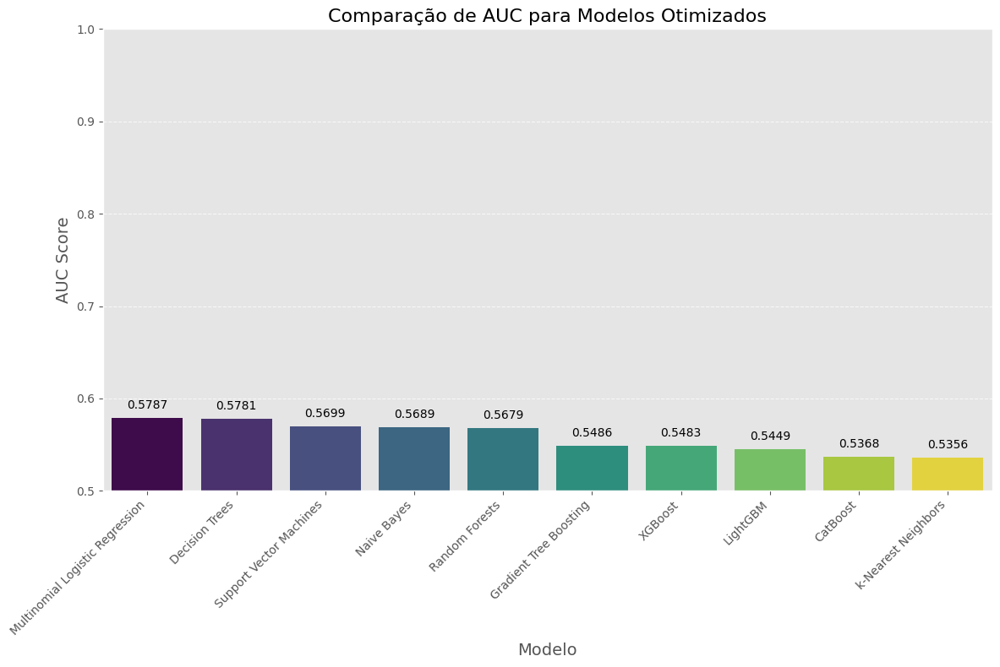


Treinando e avaliando modelos com os melhores hiperparâmetros...

=== Treinamento e Avaliação de Modelos Otimizados ===


Treinando modelos:   0%|          | 0/10 [00:00<?, ?it/s]


Treinando e avaliando Decision Trees...
  Fold 1/10


UnboundLocalError: cannot access local variable 'accuracy' where it is not associated with a value

In [ ]:
_, best_params, results, resultds_df = buscar_hiperparametros()